In [23]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scipy as sc
import seaborn as sns
import math
import json
import random
from sklearn.model_selection import train_test_split
import joblib
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.neighbors import KNeighborsClassifier
import tensorflow as tf

In [24]:
with open('../datasets/dryer_labels.txt', 'r') as f:
    lines = f.readlines()
for line in lines:
    print(line)

Energy Rating Data Dictionary for Clothes Dryers (labelled) as at May 2015



Column - Column Identifier - Description

ApplStandard - Registration.regulatory_standard - This is the legal standard to which the appliance must comply

Brand - Model.brand_name - This is the manufacturers brand

Combination - is_combination_washer_dryer - The appliance may be a combination washer/dryer

Control	- control - select appropriate type from the list

Country - Registration.registrationmanufacturingcountry_set - Country of manufacture

Depth - dimension_depth - Insert overall dimension in mm

Height - dimension_height - Insert overall dimension in mm

Model Name - Registration.get_model_name_display_display - Model name

Model No - Model.model_number - Model number

N-Standard - Registration.test_standard - This is the test standard used for the appliance, usually denoted with the prefix AS/NZS xxxxxxx

New CEC - cec - This is the current Comparative Energy Consumption of the product which is its

In [25]:
data = pd.read_csv('../datasets/dryer.csv')
ranges = {}
print(data.info())
print(data.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 397 entries, 0 to 396
Data columns (total 32 columns):
ApplStandard                397 non-null object
Brand                       397 non-null object
Cap                         397 non-null float64
Combination                 397 non-null bool
Control                     397 non-null object
Country                     397 non-null object
Depth                       223 non-null float64
Height                      223 non-null float64
Model No                    397 non-null object
Family Name                 106 non-null object
N-Standard                  397 non-null object
New CEC                     397 non-null int64
New SRI                     397 non-null float64
New Star                    397 non-null float64
Prog Name                   397 non-null object
Prog Time                   397 non-null float64
Sold_in                     387 non-null object
SubmitStatus                397 non-null object
Submit_ID                   

In [26]:
# Let us first find see the features which we might have to drop
print(data.columns.values)

# As we can see here, Grand Date and Old Star Rating are entirely empty so we can drop them
print(data.isnull().sum(), '\n')

# For each of these features, more than 97% of the values are the same, we can drop these as well
print(pd.value_counts(data['N-Standard']), '\n')
print(pd.value_counts(data['SubmitStatus']), '\n')
print(pd.value_counts(data['Product Class']), '\n')
print(pd.value_counts(data['Availability Status']), '\n')

# Since we are also finding the star index of appliances which have passed their expiry date, we will remove that as well
columns = ['Model No', 'Family Name', 'Sold_in', 'N-Standard', 'SubmitStatus', 'Submit_ID', 'GrandDate', 'Product Class', 'Product Website', 'Old Star Rating', 'Star Image Large', 'Star Image Small', 'Availability Status', 'Representative Brand URL', 'ExpDate']

# Dropping the columns
data.drop(columns, axis=1, inplace=True)
print(data.head(4), '\n')
print(data.info())

['ApplStandard' 'Brand' 'Cap' 'Combination' 'Control' 'Country' 'Depth'
 'Height' 'Model No' 'Family Name' 'N-Standard' 'New CEC' 'New SRI'
 'New Star' 'Prog Name' 'Prog Time' 'Sold_in' 'SubmitStatus' 'Submit_ID'
 'Test_Moist_Remove' 'Tot_Wat_Cons' 'Type' 'Width' 'ExpDate' 'GrandDate'
 'Product Class' 'Availability Status' 'Product Website'
 'Representative Brand URL' 'Old Star Rating' 'Star Image Large'
 'Star Image Small']
ApplStandard                  0
Brand                         0
Cap                           0
Combination                   0
Control                       0
Country                       0
Depth                       174
Height                      174
Model No                      0
Family Name                 291
N-Standard                    0
New CEC                       0
New SRI                       0
New Star                      0
Prog Name                     0
Prog Time                     0
Sold_in                      10
SubmitStatus               

In [27]:
# Fill up missing value columns
missing_values_columns = [column for column in data.columns.values if data[column].isnull().sum()>0]
print(missing_values_columns)

['Depth', 'Height', 'Tot_Wat_Cons', 'Width']


In [28]:
# Firstly we shall combine Brand and Country into a single column
Brand_Country = []
for index, row in data.iterrows():
    if len(row['Country'])>1: 
        Brand_Country.append((row['Brand'][:2] + row['Country'][0][:1] + row['Country'][1][:1]).upper())
    else: 
        Brand_Country.append((row['Brand'][:2] + row['Country'][0][:1]).upper())
data['Brand_Country'] = Brand_Country
data['Brand_Country']

0      NOCH
1      TUCH
2      ACCH
3      TRCH
4      INIT
5      INIT
6      INIT
7      ARIT
8      ARIT
9      ARIT
10     MIGE
11     LGSO
12     MIGE
13     BOPO
14     LGSO
15     ASSL
16     FICH
17     FICH
18     CECH
19     CECH
20     CECH
21     CECH
22     EUTU
23     SASO
24     GACH
25     GACH
26     SHCH
27     PYCH
28     SASO
29     STCH
       ... 
367    INCH
368    INCH
369    INCH
370    INCH
371    BLCH
372    SACH
373    ELTH
374    ELTH
375    GOSL
376    HISL
377    HISL
378    EUCH
379    ELPO
380    OMCH
381    KOCH
382    KOCH
383    KOCH
384    KOCH
385    INCH
386    BOPO
387    SIPO
388    BOPO
389    PRCH
390    MIGE
391    EUCH
392    EVCH
393    MICH
394    MIGE
395    MIGE
396    MIGE
Name: Brand_Country, Length: 397, dtype: object

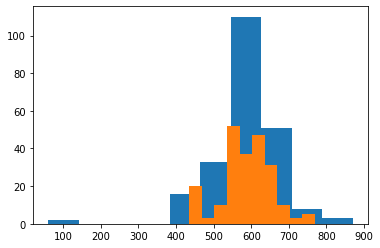

0.0      174
555.0     26
622.0     13
615.0     12
435.0     12
545.0     11
630.0     10
580.0     10
600.0      9
640.0      8
595.0      7
535.0      6
690.0      6
660.0      6
550.0      5
585.0      5
625.0      5
636.0      5
540.0      5
643.0      5
582.0      4
565.0      4
530.0      4
465.0      4
755.0      3
440.0      3
665.0      3
609.0      3
645.0      2
60.0       2
870.0      2
610.0      2
700.0      2
605.0      1
726.0      1
675.0      1
670.0      1
767.0      1
598.0      1
495.0      1
835.0      1
620.0      1
650.0      1
560.0      1
438.0      1
770.0      1
480.0      1
714.0      1
470.0      1
590.0      1
637.0      1
711.0      1
Name: Depth, dtype: int64
2    130
1    117
3     92
0     58
Name: Depth, dtype: int64


In [29]:
plt.hist(data.Depth)
plt.hist(data.loc[(data.Depth>400) & (data.Depth<800), 'Depth'])
plt.show()

# To fill missing values in Depth
mode_depth_overall = data['Depth'].value_counts().index[0]
data['Depth'] = data['Depth'].fillna(0)
print(data.Depth.value_counts())
for index, row in data.iterrows():
    if int(row['Depth']) == 0:
        brand_country_mode = int(data.loc[data['Brand_Country']==row['Brand_Country']]['Depth'].mode().values[0])
        country_mode = int(data.loc[data['Country']==row['Country']]['Depth'].mode().values[0])
        if brand_country_mode!=0:
            depth = brand_country_mode
        elif country_mode!=0:
            depth = country_mode
        else: 
            depth = mode_depth_overall
    else: 
        depth = int(data.at[index, 'Depth'])
    
    if depth>=60 and depth<=550: value = 0
    elif depth==555: value = 1
    elif depth>=560 and depth<=700: value = 2
    else: value = 3
    data.at[index, 'Depth'] = value
    
data['Depth'] = data['Depth'].astype(int)
print(data['Depth'].value_counts())
# len(data[(data['Depth']>450) & (data['Depth']<600)])

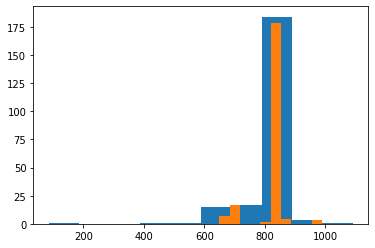

0.0       174
850.0      88
840.0      38
845.0      34
700.0      17
846.0      13
595.0       6
830.0       5
670.0       4
860.0       4
650.0       2
600.0       2
990.0       2
800.0       2
560.0       1
982.0       1
435.0       1
671.0       1
1092.0      1
85.0        1
Name: Height, dtype: int64


2    134
4    103
3     89
1     69
0      2
Name: Height, dtype: int64

In [30]:
plt.hist(data.Height)
plt.hist(data.loc[(data.Height>600) & (data.Height<1000), 'Height'])
plt.show()

# To fill missing values in Height
mode_height_overall = data['Height'].value_counts().index[1]
data['Height'] = data['Height'].fillna(0)
print(data.Height.value_counts())
for index, row in data.iterrows():
    if int(data.at[index, 'Height']) == 0:
        brand_country_mode = int(data.loc[data['Brand_Country']==row['Brand_Country']]['Height'].mode().values[0])
        country_mode = int(data.loc[data['Country']==row['Country']]['Height'].mode().values[0])
        if brand_country_mode!=0:
            height = brand_country_mode
        elif country_mode!=0:
            height = country_mode
        else: 
            height = mode_depth_overall
    else: 
        height = int(data.at[index, 'Height'])
    
    if height>=85 and height<=550: value = 0
    elif height==555: value = 1
    elif height>=560 and height<850: value = 2
    elif height==850: value = 3
    else: value = 4
    data.at[index, 'Height'] = value
data['Height'] = data['Height'].astype(int)
data['Height'].value_counts()

In [31]:
# For total water consumption, since the mode value is 0 by a very large margin, 
# we will fill the empty values with 0
data['Tot_Wat_Cons'] = data['Tot_Wat_Cons'].fillna(0)
data['Tot_Wat_Cons'] = data['Tot_Wat_Cons'].astype(int)
print(data.Tot_Wat_Cons.value_counts())
for index, rows in data.iterrows():
    water_cons = data.at[index, 'Tot_Wat_Cons']
    if water_cons==0: value = 0
    else: value = 1
    data.at[index, 'Tot_Wat_Cons'] = value
data.Tot_Wat_Cons = data.Tot_Wat_Cons.astype(int)
data.Tot_Wat_Cons.value_counts()

0      329
33       9
25       7
42       6
16       3
1        3
23       3
22       2
41       2
46       2
21       2
100      2
58       2
72       2
29       1
19       1
14       1
12       1
6        1
4        1
3        1
18       1
147      1
35       1
37       1
142      1
47       1
48       1
50       1
52       1
53       1
57       1
65       1
67       1
71       1
88       1
39       1
Name: Tot_Wat_Cons, dtype: int64


0    329
1     68
Name: Tot_Wat_Cons, dtype: int64

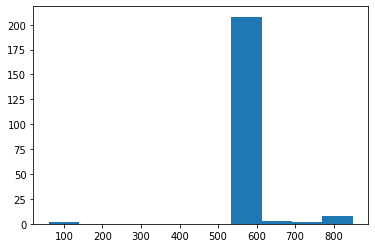

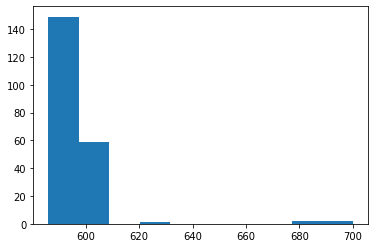

0.0      174
595.0    132
600.0     59
596.0     12
850.0      6
597.0      4
700.0      2
830.0      2
60.0       2
586.0      1
630.0      1
683.0      1
686.0      1
Name: Width, dtype: int64


1    208
0    102
2     87
Name: Width, dtype: int64

In [32]:
plt.hist(data.Width)
plt.show()
plt.hist(data.loc[(data.Width>500) & (data.Width<800), 'Width'])
plt.show()

# To fill missing values in Width
mode_height_overall = data['Width'].value_counts().index[0]
data['Width'] = data['Width'].fillna(0)
print(data.Width.value_counts())
for index, row in data.iterrows():
    if int(row['Width']) == 0:
        brand_country_mode = int(data.loc[data['Brand_Country']==row['Brand_Country']]['Width'].mode().values[0])
        country_mode = int(data.loc[data['Country']==row['Country']]['Width'].mode().values[0])
        if brand_country_mode!=0:
            width = brand_country_mode
        elif country_mode!=0:
            width = country_mode
        else: 
            width = mode_depth_overall
    else: 
        width = int(data.at[index, 'Width'])
    
    if width>=60 and width<595: value = 0
    elif width==595: value = 1
    elif width>=600 and width<850: value = 2
    data.at[index, 'Width'] = value
data['Width'] = data['Width'].astype(int)
data.Width.value_counts()

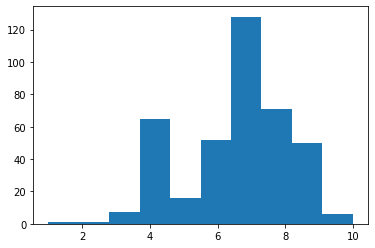

7.0     119
8.0      70
9.0      44
4.5      41
6.0      41
4.0      24
5.0      16
5.5      11
6.5       9
8.5       6
3.5       6
10.0      6
7.5       1
1.0       1
3.0       1
2.5       1
Name: Cap, dtype: int64


1    196
0    151
2     50
Name: Cap, dtype: int64

In [33]:
plt.hist(data.Cap)
plt.show()

# Converting Cap to integer classes
print(data.Cap.value_counts())
for index, rows in data.iterrows():
    capacity = int(data.at[index, 'Cap'])
    if capacity>=1 and capacity<=6: value = 0
    elif capacity>=7 and capacity<=8: value = 1
    else: value = 2
    data.at[index, 'Cap'] = value    
data['Cap'] = data['Cap'].astype(int)

ranges['Cap'] = {0:(1,6), 1:(7,8), 2:(9,10)}

data.Cap.value_counts()

In [34]:
# Converting New Star rating to Integer Classes
data['New Star'] = data['New Star'].astype(int)
print(data['New Star'].value_counts())
for index, rows in data.iterrows():
    star = data.at[index, 'New Star']
    if star==1 : value = 0
    elif star == 2: value = 1
    elif star>=3: value = 2
    data.at[index, 'New Star'] = value

data['New Star'].value_counts()

2     215
3      38
1      38
7      30
6      30
8      23
9      15
4       5
10      2
5       1
Name: New Star, dtype: int64


1    215
2    144
0     38
Name: New Star, dtype: int64

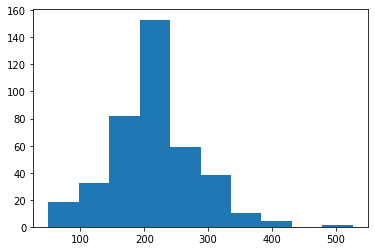

200    18
198    12
210    12
208    12
216    11
90     10
230     9
220     9
187     8
280     7
140     7
290     7
114     6
162     6
170     6
150     6
283     6
186     6
160     5
215     5
310     5
164     5
202     5
196     4
275     4
271     4
209     4
135     4
58      4
180     4
       ..
227     1
228     1
254     1
251     1
232     1
233     1
235     1
237     1
243     1
244     1
386     1
266     1
292     1
268     1
175     1
178     1
182     1
185     1
250     1
285     1
188     1
191     1
192     1
282     1
278     1
276     1
203     1
273     1
270     1
526     1
Name: Prog Time, Length: 142, dtype: int64


3    72
5    55
4    52
2    45
7    43
6    43
8    31
1    29
0    27
Name: Prog Time, dtype: int64

In [35]:
plt.hist(data['Prog Time'])
plt.show()

# Converting Prog Time to integer classes
data['Prog Time'] = data['Prog Time'].astype(int)
print(data['Prog Time'].value_counts())
for index, rows in data.iterrows():
    time = data.at[index, 'Prog Time']
    if time>=50 and time<=115 : value = 0
    elif time>115 and time<=150: value = 1
    elif time>150 and time<=175: value = 2
    elif time>175 and time<=200: value = 3
    elif time>200 and time<=215: value = 4
    elif time>215 and time<=235: value = 5
    elif time>235 and time<=275: value = 6
    elif time>275 and time<=300: value = 7
    elif time>300: value = 8
    data.at[index, 'Prog Time'] = value

ranges['Prog Time'] = {0:(50,115),1:(115,150),2:(150,175),3:(175,200),4:(200,215),5:(215,235),6:(235,275),7:(275,300),8:(300,500)}
    
data['Prog Time'].value_counts()

In [36]:
# Since the common mass removed is 5, we shall keep that as a integer category,
# along with the ones below and above it
data['Test_Moist_Remove'] = data['Test_Moist_Remove'].astype(int)
print(data.Test_Moist_Remove.value_counts())
for index, rows in data.iterrows():
    moist = data.at[index, 'Test_Moist_Remove']
    if moist<5 : value = 0
    elif moist==5: value = 1
    elif moist>5: value = 2
    data.at[index, 'Test_Moist_Remove'] = value
data.Test_Moist_Remove.value_counts()

5       131
3        75
6        74
4        59
7        47
2         6
4844      1
9         1
8         1
1         1
0         1
Name: Test_Moist_Remove, dtype: int64


0    142
1    131
2    124
Name: Test_Moist_Remove, dtype: int64

In [37]:
# Converting CEC into smaller integer classes using feature scaling
data['New CEC'] = data['New CEC'].astype(int)
cec_range = data['New CEC'].max() - data['New CEC'].min()
cec_mean = data['New CEC'].mean()
for index, rows in data.iterrows():
    cec = (data.at[index, 'New CEC'] - cec_mean)/cec_range
    if cec>-0.5 and cec<=-0.25: value = 0
    elif cec>-0.25 and cec<=-0.175: value = 1
    elif cec>-0.175 and cec<=-0.15: value = 2
    elif cec>-0.15 and cec<=-0.05: value = 3
    elif cec>-0.05 and cec<=0: value = 4
    elif cec>0 and cec<=0.15: value = 5
    elif cec>0.15 and cec<=0.25: value = 6
    elif cec>0.25 and cec<=0.5: value = 7
    else: value = 8
    data.at[index, 'New CEC'] = value

forms = [[-0.5,-0.25],[-0.25,-0.175],[-0.175,-0.15],[-0.15,-0.05],[-0.05,0],[0,0.15],[0.15,0.25],[0.25,0.5]]
ranges['New CEC'] = {}
for i in range(len(forms)):
    ranges['New CEC'][str(i)] = [forms[i][0]*cec_range+cec_mean, forms[i][1]*cec_range+cec_mean]

data['New CEC'].value_counts()

6    73
5    73
1    70
3    65
7    43
0    36
4    18
2    17
8     2
Name: New CEC, dtype: int64

In [38]:
# We shall extract the features fro the Program Name and seperate them into different classes
def return_features(data, index):
    program = data.at[index, 'Prog Name']
    if '/' in program:
        types = program.split('/')
        program = ''
        for t in types:
            program+=t+' '
    if ',' in program:
        types = program.split(',')
        program = ''
        for t in types:
            program+=t+' '
    keywords = program.split(' ')
    features = []
    for i in keywords: 
        i = i.strip()
        if i not in ['', '-']: features.append(i.lower())
    print(index, features)
    return features
    
for i, row in data.iterrows():
    features = return_features(data, i)
    if 'dry' in features and 'heat' in features: data.at[i, 'Prog Name'] = 0
    elif 'heat' in features: data.at[i,'Prog Name'] = 1
    elif 'dry' in features: data.at[i, 'Prog Name'] = 2
    else: data.at[i, 'Prog Name'] = 3

data['Prog Name'] = data['Prog Name'].astype(int)
data['Prog Name'].value_counts()

0 ['strong', 'heat']
1 ['extra', 'dry', 'full', 'load']
2 ['extra', 'dry', 'full', 'load']
3 ['extra', 'dry', 'full', 'load']
4 ['11', 'cottons', 'cupboard', 'dry']
5 ['11', 'cottons', 'cupboard', 'dry']
6 ['11', 'cottons', 'cupboard', 'dry']
7 ['11', 'cotton', 'cupboard', 'dry']
8 ['11', 'cotton', 'cupboard', 'dry']
9 ['11', 'cotton', 'cupboard', 'dry']
10 ['cottons', 'normal', '+']
11 ['cotton', 'cupboard']
12 ['cottons', 'extra', 'dry']
13 ['cottons', 'cupboard', 'dry', 'extra']
14 ['cotton', 'cupboard']
15 ['auto', 'normal', 'dry']
16 ['everyday']
17 ['everyday']
18 ['extra', 'dry', 'full', 'heat']
19 ['extra', 'dry', 'full', 'heat']
20 ['extra', 'dry', 'full', 'heat']
21 ['extra', 'dry', 'full', 'heat']
22 ['cotton', 'extra', 'dry']
23 ['drying', 'cotton', 'extra', 'dry', 'drying', 'level', 'high']
24 ['strong']
25 ['strong']
26 ['full', 'heat']
27 ['full', 'heat', 'extra', 'dry']
28 ['drying', 'cotton', 'extra', 'dry', 'drying', 'level', 'high']
29 ['regular', 'extra', 'dry', 'pr

2    219
3    147
1     17
0     14
Name: Prog Name, dtype: int64

In [39]:
# As we can see we have removed all the null values are removed, now we must convert all the other data type
# to int type, by mapping boolean and objects to int
ApplStandard_types = {'AS/NZS 2442.2:2000/Amdt 2:2007 (Legacy)': 0, 'Greenhouse and Energy Minimum Standards (Rotary Clothes Dryers) Determination 2012': 1, 'Greenhouse and Energy Minimum Standards (Rotary Clothes Dryers) Determination 2015': 2, 'AS/NZS 2442.2:2000/Amdt 2:2007': 3}
data['ApplStandard'] = data['ApplStandard'].map(ApplStandard_types).astype(int)
data['Combination'] = data['Combination'].map({False: 0, True: 1}).astype(int)
data['Control'] = data['Control'].map({'Timer': 0, 'Autosensing': 1, 'Manual': 2}).astype(int)
data['Type'] = data['Type'].map({'Condenser': 0, 'Vented': 1}).astype(int)

ranges['Combination'] = {0: 'False', 1: 'True'}
ranges['Type'] = {0: 'Condensor', 1: 'Vented'}

# We have converted all the initial types into integer type
# For now we shall not consider the effects of Brand_country, Brand and Country
data.drop(['Brand_Country', 'Brand', 'Country', 'New SRI'], axis=1, inplace=True)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 397 entries, 0 to 396
Data columns (total 14 columns):
ApplStandard         397 non-null int64
Cap                  397 non-null int64
Combination          397 non-null int64
Control              397 non-null int64
Depth                397 non-null int64
Height               397 non-null int64
New CEC              397 non-null int64
New Star             397 non-null int64
Prog Name            397 non-null int64
Prog Time            397 non-null int64
Test_Moist_Remove    397 non-null int64
Tot_Wat_Cons         397 non-null int64
Type                 397 non-null int64
Width                397 non-null int64
dtypes: int64(14)
memory usage: 43.5 KB


In [40]:
# As we can see from the heatmap plot below, Test_Moist_Remove and Capacity show high Correlation,
# So does Combination and Tot_Wat_Cons - Thus we can drop one of each pairs of correlated columns
data.drop(['Tot_Wat_Cons', 'Test_Moist_Remove'], axis=1, inplace=True)
data.head(3)

,ApplStandard,Cap,Combination,Control,Depth,Height,New CEC,New Star,Prog Name,Prog Time,Type,Width
0,0,0,0,0,1,1,3,1,1,3,1,1
1,0,0,0,1,3,2,5,1,2,5,1,2
2,0,0,0,1,1,1,5,1,2,5,1,1


In [41]:
train_x = data.drop('New Star', axis=1)
train_y = data['New Star']
train_x, test_x, train_y, test_y = train_test_split(train_x, train_y, test_size=0.2, random_state=1)

train_x

,ApplStandard,Cap,Combination,Control,Depth,Height,New CEC,Prog Name,Prog Time,Type,Width
298,2,0,0,1,0,2,5,3,1,1,1
13,2,2,0,1,1,1,2,2,5,0,0
376,2,1,0,1,2,3,6,3,3,0,2
61,1,1,0,1,1,2,6,2,2,0,1
346,2,0,0,0,0,2,3,3,3,1,2
211,2,0,1,1,2,3,1,2,3,0,1
224,2,1,0,1,2,2,0,2,7,0,1
257,2,1,0,1,3,4,6,2,5,1,1
332,2,0,1,1,1,4,3,2,8,0,2
354,2,1,0,1,3,4,1,2,5,0,0


In [46]:
# train_x.head()
dataset = tf.data.Dataset.from_tensor_slices((train_x.values, train_y.values))

for feat, targ in dataset.take(5):
    print('Features: {}, Target: {}'.format(feat, targ))

Features: Tensor("IteratorGetNext:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7:1", sha

Features: Tensor("IteratorGetNext_240:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_240:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_247:0", shape=(11,), dtype=int64), Target:

Features: Tensor("IteratorGetNext_412:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_412:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_413:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_413:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_414:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_414:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_415:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_415:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_416:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_416:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_417:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_417:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_418:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_418:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_419:0", shape=(11,), dtype=int64), Target:

Features: Tensor("IteratorGetNext_555:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_555:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_556:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_556:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_557:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_557:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_561:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_561:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_562:0", shape=(11,), dtype=int64), Target:

Features: Tensor("IteratorGetNext_787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_791:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_791:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_792:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_792:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_793:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_793:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_794:0", shape=(11,), dtype=int64), Target:

Features: Tensor("IteratorGetNext_1010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1016:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1016:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1017:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_1226:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1226:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1227:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1227:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1228:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1228:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1229:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1229:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1230:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1230:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1233:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_1426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1433:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_1637:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1637:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1638:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1638:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1639:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1639:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1640:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1640:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1641:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1641:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1642:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1642:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1643:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1643:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1644:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_1840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1844:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1844:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1846:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_1846:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_1847:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_2032:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2032:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2033:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2033:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2034:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2034:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2035:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2035:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2036:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2036:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2039:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_2250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2253:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2253:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2254:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2254:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2255:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2255:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2256:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2256:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2257:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_2480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2486:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2486:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2487:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_2710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2712:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2712:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2713:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2713:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2714:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2714:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2715:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2715:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2716:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2716:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2717:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_2945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2951:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_2951:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_2952:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_3174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3175:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3175:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3176:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3176:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3177:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3177:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3178:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3178:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3180:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3180:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3181:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_3300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3307:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_3531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3532:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3532:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3533:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3533:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3538:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_3770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_3776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_3777:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_4000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4001:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4001:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4002:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4002:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4007:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_4230:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4230:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4237:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_4465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4466:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4466:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4472:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_4693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4697:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4697:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4699:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4699:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4700:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_4926:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4926:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4927:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4927:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4928:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4928:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4929:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4929:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4930:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4930:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4931:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4931:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4932:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_4932:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_4933:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_5059:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5059:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5062:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5062:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5066:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_5282:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5282:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5283:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5283:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5284:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5284:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5285:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5285:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5286:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5286:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5287:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5287:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5288:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5288:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5289:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_5515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5516:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5516:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5517:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5517:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5518:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5518:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5519:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5519:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5520:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5520:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5522:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_5744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5746:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5746:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5749:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5749:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5750:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5750:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5751:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_5972:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5972:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5973:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5973:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5974:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5974:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5975:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5975:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5976:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5976:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5977:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5977:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5978:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_5978:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_5979:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_6197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6200:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6200:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6201:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6201:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6202:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6202:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6203:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6203:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6204:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_6424:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6424:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6431:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_6653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6659:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6659:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6660:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_6882:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6882:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6883:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6883:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_6888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_6889:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_7113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7116:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7116:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7117:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7117:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7118:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7118:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7119:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7119:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7120:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_7244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7251:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_7479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7486:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_7630:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7630:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7631:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7631:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7632:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7632:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7633:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7633:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7634:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7634:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7635:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7635:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7636:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7636:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7637:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_7807:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7807:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7809:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7809:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7811:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7811:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7812:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7812:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7813:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_7813:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_7814:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_8019:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8019:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8021:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8021:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8022:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8022:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8026:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_8216:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8216:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8217:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8217:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8223:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_8384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8391:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_8604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8611:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_8760:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8760:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8761:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8761:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8762:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8762:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8763:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8763:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8764:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8764:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8765:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8765:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8766:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8766:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8767:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_8968:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8968:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8969:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8969:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8971:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8971:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8972:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8972:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8973:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8973:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8974:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_8974:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_8975:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_9180:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9180:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9181:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9181:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9182:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9182:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9183:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9183:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9184:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9184:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9185:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9185:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9187:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_9351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9358:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_9543:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9543:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9544:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9544:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9545:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9545:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9546:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9546:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9547:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9547:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9548:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9548:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9549:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9549:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9550:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_9771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9778:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_9977:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9977:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9978:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9978:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9979:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9979:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9980:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9980:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_9983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_9984:0", shape=(11,), dtype=

Features: Tensor("IteratorGetNext_10065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10072:0", shap

Features: Tensor("IteratorGetNext_10207:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10207:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10208:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10208:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10209:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10209:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10210:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10210:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10211:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10211:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10212:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10212:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10213:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10213:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10214:0", shap

Features: Tensor("IteratorGetNext_10383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10390:0", shap

Features: Tensor("IteratorGetNext_10611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10613:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10613:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10614:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10614:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10615:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10615:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10616:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10616:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10618:0", shap

Features: Tensor("IteratorGetNext_10753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10755:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10755:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10758:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10758:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10759:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10759:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10760:0", shap

Features: Tensor("IteratorGetNext_10928:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10928:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10929:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10929:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10930:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10930:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10931:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10931:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10932:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10932:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10933:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10933:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10934:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_10934:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_10935:0", shap

Features: Tensor("IteratorGetNext_11151:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11151:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11152:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11152:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11153:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11153:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11154:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11154:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11155:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11155:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11156:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11156:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11157:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11157:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11158:0", shap

Features: Tensor("IteratorGetNext_11361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11364:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11364:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11365:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11365:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11366:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11366:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11367:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11367:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11368:0", shap

Features: Tensor("IteratorGetNext_11535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11542:0", shap

Features: Tensor("IteratorGetNext_11751:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11751:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11752:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11752:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11755:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11755:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11758:0", shap

Features: Tensor("IteratorGetNext_11978:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11978:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11979:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11979:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11980:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11980:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_11984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_11985:0", shap

Features: Tensor("IteratorGetNext_12196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12200:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12200:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12201:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12201:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12202:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12202:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12203:0", shap

Features: Tensor("IteratorGetNext_12398:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12398:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12399:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12399:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12405:0", shap

Features: Tensor("IteratorGetNext_12630:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12630:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12631:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12631:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12632:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12632:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12633:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12633:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12634:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12634:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12635:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12635:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12636:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12636:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12637:0", shap

Features: Tensor("IteratorGetNext_12849:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12849:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12850:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12850:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12851:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12851:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12852:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12852:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12853:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12853:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12854:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12854:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12855:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_12855:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_12856:0", shap

Features: Tensor("IteratorGetNext_13073:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13073:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13074:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13074:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13075:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13075:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13076:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13076:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13077:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13077:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13078:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13078:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13079:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13079:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13080:0", shap

Features: Tensor("IteratorGetNext_13297:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13297:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13298:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13298:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13299:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13299:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13304:0", shap

Features: Tensor("IteratorGetNext_13523:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13523:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13524:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13524:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13530:0", shap

Features: Tensor("IteratorGetNext_13802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13803:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13803:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13807:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13807:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_13808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_13809:0", shap

Features: Tensor("IteratorGetNext_14023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14026:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14026:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14030:0", shap

Features: Tensor("IteratorGetNext_14244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14251:0", shap

Features: Tensor("IteratorGetNext_14466:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14466:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14473:0", shap

Features: Tensor("IteratorGetNext_14692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14697:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14697:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14699:0", shap

Features: Tensor("IteratorGetNext_14911:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14911:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14912:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14912:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14917:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_14917:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_14918:0", shap

Features: Tensor("IteratorGetNext_15119:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15119:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15120:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15120:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15121:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15121:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15122:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15122:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15123:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15123:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15126:0", shap

Features: Tensor("IteratorGetNext_15321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15327:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15327:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15328:0", shap

Features: Tensor("IteratorGetNext_15536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15542:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15542:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15543:0", shap

Features: Tensor("IteratorGetNext_15752:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15752:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15755:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15755:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15758:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15758:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15759:0", shap

Features: Tensor("IteratorGetNext_15960:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15960:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_15966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_15967:0", shap

Features: Tensor("IteratorGetNext_16164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16171:0", shap

Features: Tensor("IteratorGetNext_16380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16387:0", shap

Features: Tensor("IteratorGetNext_16596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16603:0", shap

Features: Tensor("IteratorGetNext_16771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16778:0", shap

Features: Tensor("IteratorGetNext_16883:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16883:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16890:0", shap

Features: Tensor("IteratorGetNext_16982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16988:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_16988:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_16989:0", shap

Features: Tensor("IteratorGetNext_17104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17111:0", shap

Features: Tensor("IteratorGetNext_17245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17252:0", shap

Features: Tensor("IteratorGetNext_17467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17473:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17473:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17474:0", shap

Features: Tensor("IteratorGetNext_17667:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17667:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17668:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17668:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17669:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17669:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17670:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17670:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17671:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17671:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17672:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17672:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17673:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17673:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17674:0", shap

Features: Tensor("IteratorGetNext_17866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_17872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_17873:0", shap

Features: Tensor("IteratorGetNext_18109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18111:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18111:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18116:0", shap

Features: Tensor("IteratorGetNext_18323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18327:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18327:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18328:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18328:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18329:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18329:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18330:0", shap

Features: Tensor("IteratorGetNext_18479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18486:0", shap

Features: Tensor("IteratorGetNext_18652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18659:0", shap

Features: Tensor("IteratorGetNext_18866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_18872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_18873:0", shap

Features: Tensor("IteratorGetNext_19089:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19089:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19091:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19091:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19092:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19092:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19093:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19093:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19094:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19094:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19095:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19095:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19096:0", shap

Features: Tensor("IteratorGetNext_19306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19311:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19311:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19312:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19312:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19313:0", shap

Features: Tensor("IteratorGetNext_19468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19473:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19473:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19474:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19474:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19475:0", shap

Features: Tensor("IteratorGetNext_19644:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19644:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19645:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19645:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19646:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19646:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19647:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19647:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19648:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19648:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19649:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19649:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19651:0", shap

Features: Tensor("IteratorGetNext_19862:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19862:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19863:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19863:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19864:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19864:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19865:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19865:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_19868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_19869:0", shap

Features: Tensor("IteratorGetNext_20082:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20082:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20083:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20083:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20084:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20084:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20085:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20085:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20086:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20086:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20087:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20087:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20088:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20088:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20089:0", shap

Features: Tensor("IteratorGetNext_20257:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20257:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20258:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20258:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20259:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20259:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20260:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20260:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20261:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20261:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20263:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20263:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20264:0", shap

Features: Tensor("IteratorGetNext_20475:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20475:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20482:0", shap

Features: Tensor("IteratorGetNext_20688:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20688:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20689:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20689:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20690:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20690:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20691:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20691:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20695:0", shap

Features: Tensor("IteratorGetNext_20898:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20898:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20899:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20899:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20900:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20900:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20901:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20901:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20902:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20902:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20903:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20903:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20904:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_20904:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_20905:0", shap

Features: Tensor("IteratorGetNext_21123:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21123:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21130:0", shap

Features: Tensor("IteratorGetNext_21337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21339:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21339:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21340:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21340:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21341:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21341:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21342:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21342:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21343:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21343:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21344:0", shap

Features: Tensor("IteratorGetNext_21562:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21562:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21569:0", shap

Features: Tensor("IteratorGetNext_21784:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21784:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21791:0", shap

Features: Tensor("IteratorGetNext_21985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21988:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21988:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21989:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21989:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_21991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_21992:0", shap

Features: Tensor("IteratorGetNext_22185:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22185:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22192:0", shap

Features: Tensor("IteratorGetNext_22404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22408:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22408:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22409:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22409:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22410:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22410:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22411:0", shap

Features: Tensor("IteratorGetNext_22618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22625:0", shap

Features: Tensor("IteratorGetNext_22831:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22831:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22832:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22832:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22833:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22833:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22834:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22834:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22835:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22835:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22836:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22836:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_22837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_22838:0", shap

Features: Tensor("IteratorGetNext_23044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23051:0", shap

Features: Tensor("IteratorGetNext_23247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23253:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23253:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23254:0", shap

Features: Tensor("IteratorGetNext_23443:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23443:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23444:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23444:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23450:0", shap

Features: Tensor("IteratorGetNext_23637:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23637:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23638:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23638:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23639:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23639:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23640:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23640:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23641:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23641:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23642:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23642:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23643:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23643:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23644:0", shap

Features: Tensor("IteratorGetNext_23816:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23816:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23817:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23817:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23818:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23818:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23819:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23819:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23820:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23820:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23821:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23821:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23822:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_23822:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_23823:0", shap

Features: Tensor("IteratorGetNext_24008:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24008:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24009:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24009:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24015:0", shap

Features: Tensor("IteratorGetNext_24186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24193:0", shap

Features: Tensor("IteratorGetNext_24400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24407:0", shap

Features: Tensor("IteratorGetNext_24604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24611:0", shap

Features: Tensor("IteratorGetNext_24795:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24795:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24796:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24796:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24798:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24798:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_24801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_24802:0", shap

Features: Tensor("IteratorGetNext_25010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25016:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25016:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25017:0", shap

Features: Tensor("IteratorGetNext_25232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25238:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25238:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25239:0", shap

Features: Tensor("IteratorGetNext_25456:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25456:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25457:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25457:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25458:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25458:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25459:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25459:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25460:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25460:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25461:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25461:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25462:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25462:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25463:0", shap

Features: Tensor("IteratorGetNext_25672:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25672:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25673:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25673:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25674:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25674:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25675:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25675:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25676:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25676:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25677:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25677:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25678:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25678:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25679:0", shap

Features: Tensor("IteratorGetNext_25887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_25893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_25894:0", shap

Features: Tensor("IteratorGetNext_26102:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26102:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26109:0", shap

Features: Tensor("IteratorGetNext_26301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26308:0", shap

Features: Tensor("IteratorGetNext_26515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26516:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26516:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26517:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26517:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26518:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26518:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26519:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26519:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26520:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26520:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26522:0", shap

Features: Tensor("IteratorGetNext_26705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26712:0", shap

Features: Tensor("IteratorGetNext_26894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26897:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26897:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26898:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26898:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26899:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26899:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26900:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_26900:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_26901:0", shap

Features: Tensor("IteratorGetNext_27072:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27072:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27073:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27073:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27074:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27074:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27075:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27075:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27076:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27076:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27077:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27077:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27078:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27078:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27079:0", shap

Features: Tensor("IteratorGetNext_27278:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27278:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27279:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27279:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27280:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27280:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27281:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27281:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27282:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27282:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27283:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27283:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27284:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27284:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27285:0", shap

Features: Tensor("IteratorGetNext_27476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27483:0", shap

Features: Tensor("IteratorGetNext_27653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27659:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27659:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27660:0", shap

Features: Tensor("IteratorGetNext_27859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27862:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27862:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27863:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27863:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27864:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27864:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27865:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_27865:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_27866:0", shap

Features: Tensor("IteratorGetNext_28061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28062:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28062:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28068:0", shap

Features: Tensor("IteratorGetNext_28258:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28258:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28259:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28259:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28260:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28260:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28261:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28261:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28263:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28263:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28264:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28264:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28265:0", shap

Features: Tensor("IteratorGetNext_28465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28466:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28466:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28472:0", shap

Features: Tensor("IteratorGetNext_28676:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28676:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28677:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28677:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28678:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28678:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28679:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28679:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28680:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28680:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28681:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28681:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28682:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28682:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28683:0", shap

Features: Tensor("IteratorGetNext_28890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_28896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_28897:0", shap

Features: Tensor("IteratorGetNext_29101:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29101:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29102:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29102:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29108:0", shap

Features: Tensor("IteratorGetNext_29315:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29315:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29316:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29316:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29317:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29317:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29318:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29318:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29319:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29319:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29322:0", shap

Features: Tensor("IteratorGetNext_29526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29532:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29532:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29533:0", shap

Features: Tensor("IteratorGetNext_29742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29746:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29746:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29749:0", shap

Features: Tensor("IteratorGetNext_29956:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29956:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29957:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29957:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29958:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29958:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29959:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29959:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29960:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29960:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_29962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_29963:0", shap

Features: Tensor("IteratorGetNext_30048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30051:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30051:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30052:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30052:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30053:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30053:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30054:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30054:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30055:0", shap

Features: Tensor("IteratorGetNext_30264:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30264:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30265:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30265:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30271:0", shap

Features: Tensor("IteratorGetNext_30485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30486:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30486:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30488:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30488:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30489:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30489:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30490:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30490:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30491:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30491:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30492:0", shap

Features: Tensor("IteratorGetNext_30702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30709:0", shap

Features: Tensor("IteratorGetNext_30921:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30921:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30922:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30922:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30925:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30925:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30926:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30926:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30927:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_30927:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_30928:0", shap

Features: Tensor("IteratorGetNext_31088:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31088:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31089:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31089:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31091:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31091:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31092:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31092:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31093:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31093:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31094:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31094:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31095:0", shap

Features: Tensor("IteratorGetNext_31308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31311:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31311:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31312:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31312:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31313:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31313:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31314:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31314:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31315:0", shap

Features: Tensor("IteratorGetNext_31527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31532:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31532:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31533:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31533:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31534:0", shap

Features: Tensor("IteratorGetNext_31744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31746:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31746:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31749:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31749:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31750:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31750:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31751:0", shap

Features: Tensor("IteratorGetNext_31964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31967:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31967:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31968:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31968:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31969:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31969:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_31970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_31971:0", shap

Features: Tensor("IteratorGetNext_32177:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32177:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32178:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32178:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32180:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32180:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32181:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32181:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32182:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32182:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32183:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32183:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32184:0", shap

Features: Tensor("IteratorGetNext_32397:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32397:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32398:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32398:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32399:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32399:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32404:0", shap

Features: Tensor("IteratorGetNext_32621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32625:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32625:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32626:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32626:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32627:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32627:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32628:0", shap

Features: Tensor("IteratorGetNext_32844:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32844:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32846:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32846:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32847:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32847:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32848:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32848:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32849:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32849:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32850:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_32850:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_32851:0", shap

Features: Tensor("IteratorGetNext_33064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33071:0", shap

Features: Tensor("IteratorGetNext_33285:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33285:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33286:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33286:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33287:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33287:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33288:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33288:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33289:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33289:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33290:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33290:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33291:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33291:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33292:0", shap

Features: Tensor("IteratorGetNext_33492:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33492:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33493:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33493:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33494:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33494:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33495:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33495:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33496:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33496:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33497:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33497:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33498:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33498:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33499:0", shap

Features: Tensor("IteratorGetNext_33701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33708:0", shap

Features: Tensor("IteratorGetNext_33861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33862:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33862:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33863:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33863:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33864:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33864:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33865:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33865:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_33867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_33868:0", shap

Features: Tensor("IteratorGetNext_34067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34072:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34072:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34073:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34073:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34074:0", shap

Features: Tensor("IteratorGetNext_34196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34200:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34200:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34201:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34201:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34202:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34202:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34203:0", shap

Features: Tensor("IteratorGetNext_34338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34339:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34339:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34340:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34340:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34341:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34341:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34342:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34342:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34343:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34343:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34344:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34344:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34345:0", shap

Features: Tensor("IteratorGetNext_34476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34483:0", shap

Features: Tensor("IteratorGetNext_34610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34613:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34613:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34614:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34614:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34615:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34615:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34616:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34616:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34617:0", shap

Features: Tensor("IteratorGetNext_34748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34749:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34749:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34750:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34750:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34751:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34751:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34752:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34752:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34755:0", shap

Features: Tensor("IteratorGetNext_34908:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34908:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34909:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34909:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34910:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34910:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34911:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34911:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34912:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34912:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_34914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_34915:0", shap

Features: Tensor("IteratorGetNext_35132:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35132:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35133:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35133:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35134:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35134:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35135:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35135:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35136:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35136:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35137:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35137:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35139:0", shap

Features: Tensor("IteratorGetNext_35331:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35331:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35332:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35332:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35333:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35333:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35334:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35334:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35336:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35336:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35338:0", shap

Features: Tensor("IteratorGetNext_35520:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35520:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35522:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35522:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35523:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35523:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35524:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35524:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35527:0", shap

Features: Tensor("IteratorGetNext_35737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35744:0", shap

Features: Tensor("IteratorGetNext_35943:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35943:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_35949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_35950:0", shap

Features: Tensor("IteratorGetNext_36170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36171:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36171:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36172:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36172:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36173:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36173:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36175:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36175:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36176:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36176:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36177:0", shap

Features: Tensor("IteratorGetNext_36383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36390:0", shap

Features: Tensor("IteratorGetNext_36607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36613:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36613:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36614:0", shap

Features: Tensor("IteratorGetNext_36832:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36832:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36833:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36833:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36834:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36834:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36835:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36835:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36836:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36836:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36838:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_36838:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_36839:0", shap

Features: Tensor("IteratorGetNext_37044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37051:0", shap

Features: Tensor("IteratorGetNext_37271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37273:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37273:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37274:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37274:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37276:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37276:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37278:0", shap

Features: Tensor("IteratorGetNext_37494:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37494:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37495:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37495:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37496:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37496:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37497:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37497:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37498:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37498:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37499:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37499:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37500:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37500:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37501:0", shap

Features: Tensor("IteratorGetNext_37714:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37714:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37715:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37715:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37716:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37716:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37717:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37717:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37718:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37718:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37719:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37719:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37720:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37720:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37721:0", shap

Features: Tensor("IteratorGetNext_37935:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37935:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37936:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37936:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37937:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37937:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37938:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37938:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37939:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37939:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37940:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37940:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37941:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_37941:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_37942:0", shap

Features: Tensor("IteratorGetNext_38112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38116:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38116:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38117:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38117:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38118:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38118:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38119:0", shap

Features: Tensor("IteratorGetNext_38240:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38240:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38247:0", shap

Features: Tensor("IteratorGetNext_38361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38364:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38364:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38365:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38365:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38366:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38366:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38367:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38367:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38368:0", shap

Features: Tensor("IteratorGetNext_38490:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38490:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38491:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38491:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38492:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38492:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38493:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38493:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38494:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38494:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38495:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38495:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38496:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38496:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38497:0", shap

Features: Tensor("IteratorGetNext_38617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38624:0", shap

Features: Tensor("IteratorGetNext_38722:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38722:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38723:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38723:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38724:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38724:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38725:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38725:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38726:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38726:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38727:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38727:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38728:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38728:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38729:0", shap

Features: Tensor("IteratorGetNext_38848:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38848:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38849:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38849:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38850:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38850:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38851:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38851:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38852:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38852:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38853:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38853:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38854:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38854:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38855:0", shap

Features: Tensor("IteratorGetNext_38970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38971:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38971:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38972:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38972:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38973:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38973:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38974:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38974:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38975:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38975:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38976:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_38976:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_38977:0", shap

Features: Tensor("IteratorGetNext_39158:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39158:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39159:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39159:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39160:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39160:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39161:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39161:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39165:0", shap

Features: Tensor("IteratorGetNext_39359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39364:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39364:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39365:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39365:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39366:0", shap

Features: Tensor("IteratorGetNext_39532:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39532:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39533:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39533:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39539:0", shap

Features: Tensor("IteratorGetNext_39703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39710:0", shap

Features: Tensor("IteratorGetNext_39919:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39919:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39920:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39920:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39921:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39921:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39922:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39922:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39925:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_39925:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_39926:0", shap

Features: Tensor("IteratorGetNext_40137:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40137:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40139:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40139:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40144:0", shap

Features: Tensor("IteratorGetNext_40349:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40349:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40356:0", shap

Features: Tensor("IteratorGetNext_40564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40570:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40570:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40571:0", shap

Features: Tensor("IteratorGetNext_40756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40758:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40758:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40759:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40759:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40760:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40760:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40761:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40761:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40762:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40762:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40763:0", shap

Features: Tensor("IteratorGetNext_40966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40967:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40967:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40968:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40968:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40969:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40969:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40971:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40971:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40972:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_40972:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_40973:0", shap

Features: Tensor("IteratorGetNext_41163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41170:0", shap

Features: Tensor("IteratorGetNext_41380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41387:0", shap

Features: Tensor("IteratorGetNext_41590:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41590:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41591:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41591:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41592:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41592:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41593:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41593:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41594:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41594:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41597:0", shap

Features: Tensor("IteratorGetNext_41813:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41813:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41814:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41814:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41815:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41815:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41816:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41816:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41817:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41817:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41818:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41818:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41819:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_41819:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_41820:0", shap

Features: Tensor("IteratorGetNext_42020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42021:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42021:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42022:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42022:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42026:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42026:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42027:0", shap

Features: Tensor("IteratorGetNext_42236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42238:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42238:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42239:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42239:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42240:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42240:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42243:0", shap

Features: Tensor("IteratorGetNext_42420:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42420:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42421:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42421:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42422:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42422:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42423:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42423:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42424:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42424:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42427:0", shap

Features: Tensor("IteratorGetNext_42618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42625:0", shap

Features: Tensor("IteratorGetNext_42806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42807:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42807:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42809:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42809:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42811:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42811:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42812:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_42812:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_42813:0", shap

Features: Tensor("IteratorGetNext_43015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43016:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43016:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43017:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43017:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43018:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43018:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43019:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43019:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43021:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43021:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43022:0", shap

Features: Tensor("IteratorGetNext_43208:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43208:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43209:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43209:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43210:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43210:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43211:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43211:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43212:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43212:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43213:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43213:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43214:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43214:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43215:0", shap

Features: Tensor("IteratorGetNext_43388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43392:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43392:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43393:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43393:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43394:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43394:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43395:0", shap

Features: Tensor("IteratorGetNext_43594:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43594:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43601:0", shap

Features: Tensor("IteratorGetNext_43784:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43784:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43791:0", shap

Features: Tensor("IteratorGetNext_43989:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43989:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43992:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43992:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43993:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43993:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43994:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43994:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43995:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_43995:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_43996:0", shap

Features: Tensor("IteratorGetNext_44186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44193:0", shap

Features: Tensor("IteratorGetNext_44405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44408:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44408:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44409:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44409:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44410:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44410:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44411:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44411:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44412:0", shap

Features: Tensor("IteratorGetNext_44622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44625:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44625:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44626:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44626:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44627:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44627:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44628:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44628:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44629:0", shap

Features: Tensor("IteratorGetNext_44837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44838:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44838:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_44843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_44844:0", shap

Features: Tensor("IteratorGetNext_45055:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45055:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45056:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45056:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45057:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45057:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45058:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45058:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45059:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45059:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45062:0", shap

Features: Tensor("IteratorGetNext_45240:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45240:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45247:0", shap

Features: Tensor("IteratorGetNext_45431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45438:0", shap

Features: Tensor("IteratorGetNext_45592:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45592:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45593:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45593:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45594:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45594:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45599:0", shap

Features: Tensor("IteratorGetNext_45772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45778:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45778:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45779:0", shap

Features: Tensor("IteratorGetNext_45962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45967:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45967:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45968:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_45968:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_45969:0", shap

Features: Tensor("IteratorGetNext_46168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46171:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46171:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46172:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46172:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46173:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46173:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46175:0", shap

Features: Tensor("IteratorGetNext_46385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46392:0", shap

Features: Tensor("IteratorGetNext_46582:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46582:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46583:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46583:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46584:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46584:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46585:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46585:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46586:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46586:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46587:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46587:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46588:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46588:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46589:0", shap

Features: Tensor("IteratorGetNext_46785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46791:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46791:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46792:0", shap

Features: Tensor("IteratorGetNext_46985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46988:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46988:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46989:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46989:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_46991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_46992:0", shap

Features: Tensor("IteratorGetNext_47194:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47194:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47195:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47195:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47200:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47200:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47201:0", shap

Features: Tensor("IteratorGetNext_47390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47392:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47392:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47393:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47393:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47394:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47394:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47395:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47395:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47396:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47396:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47397:0", shap

Features: Tensor("IteratorGetNext_47596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47603:0", shap

Features: Tensor("IteratorGetNext_47795:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47795:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47796:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47796:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47798:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47798:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47802:0", shap

Features: Tensor("IteratorGetNext_47998:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47998:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_47999:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_47999:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48001:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48001:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48002:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48002:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48005:0", shap

Features: Tensor("IteratorGetNext_48193:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48193:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48194:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48194:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48195:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48195:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48200:0", shap

Features: Tensor("IteratorGetNext_48401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48408:0", shap

Features: Tensor("IteratorGetNext_48509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48514:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48514:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48516:0", shap

Features: Tensor("IteratorGetNext_48647:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48647:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48648:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48648:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48649:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48649:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48654:0", shap

Features: Tensor("IteratorGetNext_48765:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48765:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48766:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48766:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48772:0", shap

Features: Tensor("IteratorGetNext_48903:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48903:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48904:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48904:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48905:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48905:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48906:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48906:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48907:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48907:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48908:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48908:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48909:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48909:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48910:0", shap

Features: Tensor("IteratorGetNext_48985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48988:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48988:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48989:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48989:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_48991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_48992:0", shap

Features: Tensor("IteratorGetNext_49135:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49135:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49136:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49136:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49137:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49137:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49139:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49139:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49142:0", shap

Features: Tensor("IteratorGetNext_49270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49273:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49273:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49274:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49274:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49276:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49276:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49277:0", shap

Features: Tensor("IteratorGetNext_49420:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49420:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49421:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49421:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49422:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49422:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49423:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49423:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49424:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49424:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49427:0", shap

Features: Tensor("IteratorGetNext_49566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49570:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49570:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49571:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49571:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49572:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49572:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49573:0", shap

Features: Tensor("IteratorGetNext_49705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49712:0", shap

Features: Tensor("IteratorGetNext_49871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_49877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_49878:0", shap

Features: Tensor("IteratorGetNext_50063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50070:0", shap

Features: Tensor("IteratorGetNext_50230:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50230:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50237:0", shap

Features: Tensor("IteratorGetNext_50425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50432:0", shap

Features: Tensor("IteratorGetNext_50624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50625:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50625:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50626:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50626:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50627:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50627:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50628:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50628:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50629:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50629:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50630:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50630:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50631:0", shap

Features: Tensor("IteratorGetNext_50804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50807:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50807:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50809:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50809:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50811:0", shap

Features: Tensor("IteratorGetNext_50975:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50975:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50976:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50976:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50977:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50977:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50978:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50978:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50979:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50979:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50980:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50980:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_50981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_50982:0", shap

Features: Tensor("IteratorGetNext_51162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51169:0", shap

Features: Tensor("IteratorGetNext_51363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51364:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51364:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51365:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51365:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51366:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51366:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51367:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51367:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51368:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51368:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51369:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51369:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51370:0", shap

Features: Tensor("IteratorGetNext_51559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51561:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51561:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51562:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51562:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51566:0", shap

Features: Tensor("IteratorGetNext_51763:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51763:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51764:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51764:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51765:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51765:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51766:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51766:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51770:0", shap

Features: Tensor("IteratorGetNext_51961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51967:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_51967:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_51968:0", shap

Features: Tensor("IteratorGetNext_52100:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52100:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52101:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52101:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52102:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52102:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52107:0", shap

Features: Tensor("IteratorGetNext_52289:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52289:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52290:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52290:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52291:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52291:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52292:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52292:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52293:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52293:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52294:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52294:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52295:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52295:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52296:0", shap

Features: Tensor("IteratorGetNext_52471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52473:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52473:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52474:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52474:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52475:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52475:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52478:0", shap

Features: Tensor("IteratorGetNext_52664:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52664:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52665:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52665:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52666:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52666:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52667:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52667:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52668:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52668:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52669:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52669:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52670:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52670:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52671:0", shap

Features: Tensor("IteratorGetNext_52871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_52877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_52878:0", shap

Features: Tensor("IteratorGetNext_53070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53072:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53072:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53073:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53073:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53074:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53074:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53075:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53075:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53076:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53076:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53077:0", shap

Features: Tensor("IteratorGetNext_53271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53273:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53273:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53274:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53274:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53276:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53276:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53278:0", shap

Features: Tensor("IteratorGetNext_53444:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53444:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53451:0", shap

Features: Tensor("IteratorGetNext_53575:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53575:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53576:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53576:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53577:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53577:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53578:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53578:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53579:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53579:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53580:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53580:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53581:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53581:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53582:0", shap

Features: Tensor("IteratorGetNext_53705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53712:0", shap

Features: Tensor("IteratorGetNext_53853:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53853:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53854:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53854:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53855:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53855:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53856:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53856:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53857:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53857:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53860:0", shap

Features: Tensor("IteratorGetNext_53989:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53989:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53992:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53992:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53993:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53993:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53994:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53994:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53995:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_53995:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_53996:0", shap

Features: Tensor("IteratorGetNext_54141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54147:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54147:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54148:0", shap

Features: Tensor("IteratorGetNext_54319:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54319:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54326:0", shap

Features: Tensor("IteratorGetNext_54525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54532:0", shap

Features: Tensor("IteratorGetNext_54699:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54699:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54706:0", shap

Features: Tensor("IteratorGetNext_54871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_54877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_54878:0", shap

Features: Tensor("IteratorGetNext_55037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55044:0", shap

Features: Tensor("IteratorGetNext_55246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55253:0", shap

Features: Tensor("IteratorGetNext_55463:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55463:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55464:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55464:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55466:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55466:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55470:0", shap

Features: Tensor("IteratorGetNext_55673:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55673:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55674:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55674:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55675:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55675:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55676:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55676:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55677:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55677:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55678:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55678:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55679:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55679:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55680:0", shap

Features: Tensor("IteratorGetNext_55873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55879:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_55879:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_55880:0", shap

Features: Tensor("IteratorGetNext_56019:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56019:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56021:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56021:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56022:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56022:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56026:0", shap

Features: Tensor("IteratorGetNext_56230:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56230:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56237:0", shap

Features: Tensor("IteratorGetNext_56449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56452:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56452:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56453:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56453:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56454:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56454:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56455:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56455:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56456:0", shap

Features: Tensor("IteratorGetNext_56621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56625:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56625:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56626:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56626:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56627:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56627:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56628:0", shap

Features: Tensor("IteratorGetNext_56800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56803:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56803:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_56806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_56807:0", shap

Features: Tensor("IteratorGetNext_57012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57016:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57016:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57017:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57017:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57018:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57018:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57019:0", shap

Features: Tensor("IteratorGetNext_57215:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57215:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57216:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57216:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57217:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57217:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57222:0", shap

Features: Tensor("IteratorGetNext_57431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57438:0", shap

Features: Tensor("IteratorGetNext_57651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57658:0", shap

Features: Tensor("IteratorGetNext_57872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_57878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_57879:0", shap

Features: Tensor("IteratorGetNext_58095:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58095:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58096:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58096:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58097:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58097:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58098:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58098:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58099:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58099:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58100:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58100:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58101:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58101:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58102:0", shap

Features: Tensor("IteratorGetNext_58312:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58312:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58313:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58313:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58314:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58314:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58315:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58315:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58316:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58316:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58317:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58317:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58318:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58318:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58319:0", shap

Features: Tensor("IteratorGetNext_58532:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58532:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58533:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58533:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58539:0", shap

Features: Tensor("IteratorGetNext_58753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58755:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58755:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58758:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58758:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58759:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58759:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58760:0", shap

Features: Tensor("IteratorGetNext_58953:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58953:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58954:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58954:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58955:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58955:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58956:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58956:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58957:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58957:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58958:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58958:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58959:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_58959:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_58960:0", shap

Features: Tensor("IteratorGetNext_59179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59180:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59180:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59181:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59181:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59182:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59182:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59183:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59183:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59184:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59184:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59185:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59185:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59186:0", shap

Features: Tensor("IteratorGetNext_59395:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59395:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59396:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59396:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59397:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59397:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59398:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59398:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59399:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59399:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59402:0", shap

Features: Tensor("IteratorGetNext_59615:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59615:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59616:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59616:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59622:0", shap

Features: Tensor("IteratorGetNext_59841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59844:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59844:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59846:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59846:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59847:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_59847:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_59848:0", shap

Features: Tensor("IteratorGetNext_60066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60072:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60072:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60073:0", shap

Features: Tensor("IteratorGetNext_60287:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60287:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60288:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60288:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60289:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60289:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60290:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60290:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60291:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60291:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60292:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60292:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60293:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60293:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60294:0", shap

Features: Tensor("IteratorGetNext_60506:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60506:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60507:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60507:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60508:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60508:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60513:0", shap

Features: Tensor("IteratorGetNext_60722:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60722:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60723:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60723:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60724:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60724:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60725:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60725:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60726:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60726:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60727:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60727:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60728:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60728:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60729:0", shap

Features: Tensor("IteratorGetNext_60944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_60950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_60951:0", shap

Features: Tensor("IteratorGetNext_61162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61169:0", shap

Features: Tensor("IteratorGetNext_61379:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61379:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61386:0", shap

Features: Tensor("IteratorGetNext_61597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61604:0", shap

Features: Tensor("IteratorGetNext_61816:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61816:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61817:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61817:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61818:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61818:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61819:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61819:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61820:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61820:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61821:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61821:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61822:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_61822:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_61823:0", shap

Features: Tensor("IteratorGetNext_62032:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62032:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62033:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62033:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62034:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62034:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62035:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62035:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62036:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62036:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62039:0", shap

Features: Tensor("IteratorGetNext_62256:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62256:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62257:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62257:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62258:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62258:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62259:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62259:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62260:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62260:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62261:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62261:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62263:0", shap

Features: Tensor("IteratorGetNext_62475:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62475:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62482:0", shap

Features: Tensor("IteratorGetNext_62695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62697:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62697:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62699:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62699:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62702:0", shap

Features: Tensor("IteratorGetNext_62918:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62918:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62919:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62919:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62920:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62920:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62921:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62921:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62922:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62922:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_62924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_62925:0", shap

Features: Tensor("IteratorGetNext_63142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63147:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63147:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63148:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63148:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63149:0", shap

Features: Tensor("IteratorGetNext_63353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63360:0", shap

Features: Tensor("IteratorGetNext_63567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63570:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63570:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63571:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63571:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63572:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63572:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63573:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63573:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63574:0", shap

Features: Tensor("IteratorGetNext_63784:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63784:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_63790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_63791:0", shap

Features: Tensor("IteratorGetNext_64000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64001:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64001:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64002:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64002:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64007:0", shap

Features: Tensor("IteratorGetNext_64220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64225:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64225:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64226:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64226:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64227:0", shap

Features: Tensor("IteratorGetNext_64433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64438:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64438:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64439:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64439:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64440:0", shap

Features: Tensor("IteratorGetNext_64649:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64649:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64656:0", shap

Features: Tensor("IteratorGetNext_64870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_64876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_64877:0", shap

Features: Tensor("IteratorGetNext_65086:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65086:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65087:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65087:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65088:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65088:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65089:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65089:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65091:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65091:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65092:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65092:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65093:0", shap

Features: Tensor("IteratorGetNext_65307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65311:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65311:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65312:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65312:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65313:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65313:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65314:0", shap

Features: Tensor("IteratorGetNext_65517:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65517:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65518:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65518:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65519:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65519:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65520:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65520:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65522:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65522:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65523:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65523:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65524:0", shap

Features: Tensor("IteratorGetNext_65735:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65735:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65742:0", shap

Features: Tensor("IteratorGetNext_65953:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65953:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65954:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65954:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65955:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65955:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65956:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65956:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65957:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65957:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65958:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65958:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65959:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_65959:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_65960:0", shap

Features: Tensor("IteratorGetNext_66170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66171:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66171:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66172:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66172:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66173:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66173:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66175:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66175:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66176:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66176:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66177:0", shap

Features: Tensor("IteratorGetNext_66387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66392:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66392:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66393:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66393:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66394:0", shap

Features: Tensor("IteratorGetNext_66600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66607:0", shap

Features: Tensor("IteratorGetNext_66823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66829:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_66829:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_66830:0", shap

Features: Tensor("IteratorGetNext_67045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67051:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67051:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67052:0", shap

Features: Tensor("IteratorGetNext_67242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67249:0", shap

Features: Tensor("IteratorGetNext_67465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67466:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67466:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67472:0", shap

Features: Tensor("IteratorGetNext_67682:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67682:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67683:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67683:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67684:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67684:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67685:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67685:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67686:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67686:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67687:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67687:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67688:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67688:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67689:0", shap

Features: Tensor("IteratorGetNext_67890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_67896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_67897:0", shap

Features: Tensor("IteratorGetNext_68109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68111:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68111:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68116:0", shap

Features: Tensor("IteratorGetNext_68331:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68331:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68332:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68332:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68333:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68333:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68334:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68334:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68336:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68336:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68338:0", shap

Features: Tensor("IteratorGetNext_68554:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68554:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68555:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68555:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68556:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68556:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68557:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68557:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68561:0", shap

Features: Tensor("IteratorGetNext_68771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68778:0", shap

Features: Tensor("IteratorGetNext_68994:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68994:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68995:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68995:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68996:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68996:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68997:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68997:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68998:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68998:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_68999:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_68999:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69001:0", shap

Features: Tensor("IteratorGetNext_69218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69225:0", shap

Features: Tensor("IteratorGetNext_69432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69438:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69438:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69439:0", shap

Features: Tensor("IteratorGetNext_69650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69657:0", shap

Features: Tensor("IteratorGetNext_69866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_69872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_69873:0", shap

Features: Tensor("IteratorGetNext_70088:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70088:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70089:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70089:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70091:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70091:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70092:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70092:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70093:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70093:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70094:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70094:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70095:0", shap

Features: Tensor("IteratorGetNext_70301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70308:0", shap

Features: Tensor("IteratorGetNext_70519:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70519:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70520:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70520:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70522:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70522:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70523:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70523:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70524:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70524:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70526:0", shap

Features: Tensor("IteratorGetNext_70736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70743:0", shap

Features: Tensor("IteratorGetNext_70948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70951:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70951:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70952:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70952:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70953:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70953:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70954:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_70954:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_70955:0", shap

Features: Tensor("IteratorGetNext_71164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71171:0", shap

Features: Tensor("IteratorGetNext_71383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71390:0", shap

Features: Tensor("IteratorGetNext_71600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71607:0", shap

Features: Tensor("IteratorGetNext_71823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71829:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_71829:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_71830:0", shap

Features: Tensor("IteratorGetNext_72036:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72036:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72043:0", shap

Features: Tensor("IteratorGetNext_72257:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72257:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72258:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72258:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72259:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72259:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72260:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72260:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72261:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72261:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72263:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72263:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72264:0", shap

Features: Tensor("IteratorGetNext_72481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72486:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72486:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72488:0", shap

Features: Tensor("IteratorGetNext_72700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72707:0", shap

Features: Tensor("IteratorGetNext_72923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72925:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72925:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72926:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72926:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72927:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72927:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72928:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72928:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72929:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_72929:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_72930:0", shap

Features: Tensor("IteratorGetNext_73138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73139:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73139:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73145:0", shap

Features: Tensor("IteratorGetNext_73357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73364:0", shap

Features: Tensor("IteratorGetNext_73579:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73579:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73580:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73580:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73581:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73581:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73582:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73582:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73583:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73583:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73584:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73584:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73585:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73585:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73586:0", shap

Features: Tensor("IteratorGetNext_73794:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73794:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73795:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73795:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73796:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73796:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73798:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73798:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_73800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_73801:0", shap

Features: Tensor("IteratorGetNext_74014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74016:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74016:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74017:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74017:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74018:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74018:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74019:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74019:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74021:0", shap

Features: Tensor("IteratorGetNext_74222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74225:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74225:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74226:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74226:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74227:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74227:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74228:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74228:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74229:0", shap

Features: Tensor("IteratorGetNext_74440:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74440:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74441:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74441:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74442:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74442:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74443:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74443:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74444:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74444:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74447:0", shap

Features: Tensor("IteratorGetNext_74659:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74659:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74660:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74660:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74661:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74661:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74662:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74662:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74663:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74663:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74664:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74664:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74665:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74665:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74666:0", shap

Features: Tensor("IteratorGetNext_74875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74879:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74879:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74880:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74880:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74881:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_74881:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_74882:0", shap

Features: Tensor("IteratorGetNext_75090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75091:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75091:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75092:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75092:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75093:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75093:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75094:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75094:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75095:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75095:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75096:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75096:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75097:0", shap

Features: Tensor("IteratorGetNext_75307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75311:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75311:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75312:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75312:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75313:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75313:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75314:0", shap

Features: Tensor("IteratorGetNext_75521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75522:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75522:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75523:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75523:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75524:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75524:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75528:0", shap

Features: Tensor("IteratorGetNext_75737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75744:0", shap

Features: Tensor("IteratorGetNext_75952:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75952:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75953:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75953:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75954:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75954:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75955:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75955:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75956:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75956:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75957:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75957:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75958:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_75958:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_75959:0", shap

Features: Tensor("IteratorGetNext_76168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76171:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76171:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76172:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76172:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76173:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76173:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76175:0", shap

Features: Tensor("IteratorGetNext_76386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76392:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76392:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76393:0", shap

Features: Tensor("IteratorGetNext_76605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76612:0", shap

Features: Tensor("IteratorGetNext_76825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76829:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76829:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76830:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76830:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76831:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_76831:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_76832:0", shap

Features: Tensor("IteratorGetNext_77044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77051:0", shap

Features: Tensor("IteratorGetNext_77267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77273:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77273:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77274:0", shap

Features: Tensor("IteratorGetNext_77484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77486:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77486:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77488:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77488:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77489:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77489:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77490:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77490:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77491:0", shap

Features: Tensor("IteratorGetNext_77708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77712:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77712:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77713:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77713:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77714:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77714:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77715:0", shap

Features: Tensor("IteratorGetNext_77909:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77909:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77910:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77910:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77911:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77911:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77912:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77912:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_77915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_77916:0", shap

Features: Tensor("IteratorGetNext_78129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78130:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78130:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78131:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78131:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78132:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78132:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78133:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78133:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78134:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78134:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78135:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78135:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78136:0", shap

Features: Tensor("IteratorGetNext_78346:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78346:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78347:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78347:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78348:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78348:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78349:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78349:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78353:0", shap

Features: Tensor("IteratorGetNext_78413:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78413:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78414:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78414:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78415:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78415:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78416:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78416:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78417:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78417:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78418:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78418:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78419:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78419:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78420:0", shap

Features: Tensor("IteratorGetNext_78616:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78616:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78623:0", shap

Features: Tensor("IteratorGetNext_78822:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78822:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78829:0", shap

Features: Tensor("IteratorGetNext_78981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_78987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_78988:0", shap

Features: Tensor("IteratorGetNext_79193:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79193:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79194:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79194:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79195:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79195:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79200:0", shap

Features: Tensor("IteratorGetNext_79409:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79409:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79410:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79410:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79411:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79411:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79412:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79412:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79413:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79413:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79414:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79414:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79415:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79415:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79416:0", shap

Features: Tensor("IteratorGetNext_79607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79613:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79613:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79614:0", shap

Features: Tensor("IteratorGetNext_79822:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79822:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_79828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_79829:0", shap

Features: Tensor("IteratorGetNext_80027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80030:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80030:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80031:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80031:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80032:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80032:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80033:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80033:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80034:0", shap

Features: Tensor("IteratorGetNext_80185:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80185:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80192:0", shap

Features: Tensor("IteratorGetNext_80284:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80284:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80285:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80285:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80286:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80286:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80287:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80287:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80288:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80288:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80289:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80289:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80290:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80290:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80291:0", shap

Features: Tensor("IteratorGetNext_80482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80486:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80486:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80488:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80488:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80489:0", shap

Features: Tensor("IteratorGetNext_80690:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80690:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80691:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80691:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80697:0", shap

Features: Tensor("IteratorGetNext_80891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80897:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_80897:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_80898:0", shap

Features: Tensor("IteratorGetNext_81055:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81055:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81056:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81056:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81057:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81057:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81058:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81058:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81059:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81059:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81062:0", shap

Features: Tensor("IteratorGetNext_81265:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81265:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81272:0", shap

Features: Tensor("IteratorGetNext_81419:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81419:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81420:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81420:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81421:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81421:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81422:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81422:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81423:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81423:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81424:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81424:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81426:0", shap

Features: Tensor("IteratorGetNext_81563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81570:0", shap

Features: Tensor("IteratorGetNext_81721:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81721:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81722:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81722:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81723:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81723:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81724:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81724:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81725:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81725:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81726:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81726:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81727:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81727:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81728:0", shap

Features: Tensor("IteratorGetNext_81877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81879:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81879:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81880:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81880:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81881:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81881:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81882:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81882:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81883:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_81883:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_81884:0", shap

Features: Tensor("IteratorGetNext_82003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82007:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82007:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82008:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82008:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82009:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82009:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82010:0", shap

Features: Tensor("IteratorGetNext_82146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82147:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82147:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82148:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82148:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82149:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82149:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82150:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82150:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82151:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82151:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82152:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82152:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82153:0", shap

Features: Tensor("IteratorGetNext_82350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82357:0", shap

Features: Tensor("IteratorGetNext_82561:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82561:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82562:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82562:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82568:0", shap

Features: Tensor("IteratorGetNext_82741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82746:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82746:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82748:0", shap

Features: Tensor("IteratorGetNext_82923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82925:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82925:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82926:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82926:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82927:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82927:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82928:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82928:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82929:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_82929:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_82930:0", shap

Features: Tensor("IteratorGetNext_83137:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83137:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83139:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83139:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83144:0", shap

Features: Tensor("IteratorGetNext_83351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83358:0", shap

Features: Tensor("IteratorGetNext_83563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83570:0", shap

Features: Tensor("IteratorGetNext_83783:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83783:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83784:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83784:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_83789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_83790:0", shap

Features: Tensor("IteratorGetNext_84009:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84009:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84016:0", shap

Features: Tensor("IteratorGetNext_84220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84225:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84225:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84226:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84226:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84227:0", shap

Features: Tensor("IteratorGetNext_84406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84408:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84408:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84409:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84409:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84410:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84410:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84411:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84411:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84412:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84412:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84413:0", shap

Features: Tensor("IteratorGetNext_84601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84608:0", shap

Features: Tensor("IteratorGetNext_84804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84807:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84807:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84809:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84809:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_84810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_84811:0", shap

Features: Tensor("IteratorGetNext_85007:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85007:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85008:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85008:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85009:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85009:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85014:0", shap

Features: Tensor("IteratorGetNext_85218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85225:0", shap

Features: Tensor("IteratorGetNext_85426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85433:0", shap

Features: Tensor("IteratorGetNext_85631:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85631:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85632:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85632:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85633:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85633:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85634:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85634:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85635:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85635:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85636:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85636:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85637:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85637:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85638:0", shap

Features: Tensor("IteratorGetNext_85858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85862:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85862:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85863:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85863:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85864:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_85864:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_85865:0", shap

Features: Tensor("IteratorGetNext_86077:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86077:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86078:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86078:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86079:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86079:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86080:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86080:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86081:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86081:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86082:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86082:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86083:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86083:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86084:0", shap

Features: Tensor("IteratorGetNext_86304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86311:0", shap

Features: Tensor("IteratorGetNext_86530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86532:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86532:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86533:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86533:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86537:0", shap

Features: Tensor("IteratorGetNext_86733:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86733:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86734:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86734:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86735:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86735:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86740:0", shap

Features: Tensor("IteratorGetNext_86960:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86960:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_86966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_86967:0", shap

Features: Tensor("IteratorGetNext_87187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87193:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87193:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87194:0", shap

Features: Tensor("IteratorGetNext_87399:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87399:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87406:0", shap

Features: Tensor("IteratorGetNext_87628:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87628:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87629:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87629:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87630:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87630:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87631:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87631:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87632:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87632:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87633:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87633:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87634:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87634:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87635:0", shap

Features: Tensor("IteratorGetNext_87854:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87854:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87855:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87855:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87856:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87856:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87857:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87857:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_87860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_87861:0", shap

Features: Tensor("IteratorGetNext_88078:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88078:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88079:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88079:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88080:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88080:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88081:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88081:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88082:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88082:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88083:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88083:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88084:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88084:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88085:0", shap

Features: Tensor("IteratorGetNext_88308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88311:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88311:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88312:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88312:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88313:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88313:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88314:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88314:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88315:0", shap

Features: Tensor("IteratorGetNext_88535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88542:0", shap

Features: Tensor("IteratorGetNext_88735:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88735:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88742:0", shap

Features: Tensor("IteratorGetNext_88965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88967:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88967:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88968:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88968:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88969:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88969:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88971:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_88971:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_88972:0", shap

Features: Tensor("IteratorGetNext_89161:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89161:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89168:0", shap

Features: Tensor("IteratorGetNext_89377:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89377:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89378:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89378:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89379:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89379:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89384:0", shap

Features: Tensor("IteratorGetNext_89586:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89586:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89587:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89587:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89588:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89588:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89589:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89589:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89590:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89590:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89591:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89591:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89592:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89592:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89593:0", shap

Features: Tensor("IteratorGetNext_89791:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89791:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89792:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89792:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89793:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89793:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89794:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89794:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89795:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89795:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89796:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89796:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89798:0", shap

Features: Tensor("IteratorGetNext_89961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89967:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_89967:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_89968:0", shap

Features: Tensor("IteratorGetNext_90062:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90062:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90069:0", shap

Features: Tensor("IteratorGetNext_90128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90130:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90130:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90131:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90131:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90132:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90132:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90133:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90133:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90134:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90134:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90135:0", shap

Features: Tensor("IteratorGetNext_90300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90307:0", shap

Features: Tensor("IteratorGetNext_90487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90488:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90488:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90489:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90489:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90490:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90490:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90491:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90491:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90492:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90492:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90493:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90493:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90494:0", shap

Features: Tensor("IteratorGetNext_90667:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90667:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90668:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90668:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90669:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90669:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90670:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90670:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90671:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90671:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90672:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90672:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90673:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90673:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90674:0", shap

Features: Tensor("IteratorGetNext_90837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90838:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90838:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90844:0", shap

Features: Tensor("IteratorGetNext_90994:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90994:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90995:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90995:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90996:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90996:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90997:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90997:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90998:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90998:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_90999:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_90999:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91001:0", shap

Features: Tensor("IteratorGetNext_91106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91111:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91111:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91113:0", shap

Features: Tensor("IteratorGetNext_91202:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91202:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91203:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91203:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91204:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91204:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91205:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91205:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91206:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91206:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91207:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91207:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91208:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91208:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91209:0", shap

Features: Tensor("IteratorGetNext_91335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91336:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91336:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91339:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91339:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91340:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91340:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91341:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91341:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91342:0", shap

Features: Tensor("IteratorGetNext_91411:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91411:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91412:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91412:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91413:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91413:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91414:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91414:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91415:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91415:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91416:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91416:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91417:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91417:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91418:0", shap

Features: Tensor("IteratorGetNext_91554:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91554:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91555:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91555:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91556:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91556:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91557:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91557:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91561:0", shap

Features: Tensor("IteratorGetNext_91702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91709:0", shap

Features: Tensor("IteratorGetNext_91775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91778:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91778:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91779:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91779:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91780:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91780:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91781:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91781:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91782:0", shap

Features: Tensor("IteratorGetNext_91914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91917:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91917:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91918:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91918:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91919:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91919:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91920:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_91920:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_91921:0", shap

Features: Tensor("IteratorGetNext_92055:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92055:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92056:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92056:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92057:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92057:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92058:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92058:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92059:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92059:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92062:0", shap

Features: Tensor("IteratorGetNext_92202:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92202:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92203:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92203:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92204:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92204:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92205:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92205:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92206:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92206:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92207:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92207:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92208:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92208:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92209:0", shap

Features: Tensor("IteratorGetNext_92342:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92342:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92343:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92343:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92344:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92344:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92345:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92345:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92346:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92346:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92347:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92347:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92348:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92348:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92349:0", shap

Features: Tensor("IteratorGetNext_92519:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92519:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92520:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92520:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92521:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92521:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92522:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92522:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92523:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92523:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92524:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92524:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92526:0", shap

Features: Tensor("IteratorGetNext_92690:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92690:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92691:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92691:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92697:0", shap

Features: Tensor("IteratorGetNext_92875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92879:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92879:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92880:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92880:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92881:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_92881:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_92882:0", shap

Features: Tensor("IteratorGetNext_93062:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93062:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93069:0", shap

Features: Tensor("IteratorGetNext_93237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93238:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93238:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93239:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93239:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93240:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93240:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93244:0", shap

Features: Tensor("IteratorGetNext_93385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93392:0", shap

Features: Tensor("IteratorGetNext_93533:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93533:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93540:0", shap

Features: Tensor("IteratorGetNext_93700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93707:0", shap

Features: Tensor("IteratorGetNext_93881:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93881:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93882:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93882:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93883:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93883:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_93887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_93888:0", shap

Features: Tensor("IteratorGetNext_94084:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94084:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94085:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94085:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94086:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94086:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94087:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94087:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94088:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94088:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94089:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94089:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94091:0", shap

Features: Tensor("IteratorGetNext_94267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94273:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94273:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94274:0", shap

Features: Tensor("IteratorGetNext_94451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94452:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94452:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94453:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94453:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94454:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94454:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94455:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94455:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94456:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94456:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94457:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94457:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94458:0", shap

Features: Tensor("IteratorGetNext_94593:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94593:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94594:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94594:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94600:0", shap

Features: Tensor("IteratorGetNext_94786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94791:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94791:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94792:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94792:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94793:0", shap

Features: Tensor("IteratorGetNext_94990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94992:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94992:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94993:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94993:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94994:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94994:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94995:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94995:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94996:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_94996:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_94997:0", shap

Features: Tensor("IteratorGetNext_95173:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95173:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95175:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95175:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95176:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95176:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95177:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95177:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95178:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95178:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95180:0", shap

Features: Tensor("IteratorGetNext_95346:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95346:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95347:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95347:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95348:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95348:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95349:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95349:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95353:0", shap

Features: Tensor("IteratorGetNext_95534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95541:0", shap

Features: Tensor("IteratorGetNext_95739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95746:0", shap

Features: Tensor("IteratorGetNext_95910:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95910:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95911:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95911:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95912:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95912:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_95916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_95917:0", shap

Features: Tensor("IteratorGetNext_96124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96130:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96130:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96131:0", shap

Features: Tensor("IteratorGetNext_96320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96327:0", shap

Features: Tensor("IteratorGetNext_96510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96514:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96514:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96516:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96516:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96517:0", shap

Features: Tensor("IteratorGetNext_96652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96659:0", shap

Features: Tensor("IteratorGetNext_96855:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96855:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96856:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96856:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96857:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96857:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_96861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_96862:0", shap

Features: Tensor("IteratorGetNext_97027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97030:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97030:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97031:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97031:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97032:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97032:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97033:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97033:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97034:0", shap

Features: Tensor("IteratorGetNext_97219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97225:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97225:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97226:0", shap

Features: Tensor("IteratorGetNext_97375:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97375:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97376:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97376:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97377:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97377:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97378:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97378:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97379:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97379:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97382:0", shap

Features: Tensor("IteratorGetNext_97552:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97552:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97553:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97553:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97554:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97554:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97555:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97555:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97556:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97556:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97557:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97557:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97559:0", shap

Features: Tensor("IteratorGetNext_97745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97746:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97746:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97749:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97749:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97750:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97750:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97751:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97751:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97752:0", shap

Features: Tensor("IteratorGetNext_97960:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97960:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97966:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_97966:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_97967:0", shap

Features: Tensor("IteratorGetNext_98153:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98153:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98154:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98154:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98155:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98155:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98156:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98156:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98157:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98157:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98158:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98158:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98159:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98159:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98160:0", shap

Features: Tensor("IteratorGetNext_98352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98359:0", shap

Features: Tensor("IteratorGetNext_98558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98561:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98561:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98562:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98562:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98565:0", shap

Features: Tensor("IteratorGetNext_98735:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98735:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98742:0", shap

Features: Tensor("IteratorGetNext_98946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98951:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98951:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98952:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_98952:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_98953:0", shap

Features: Tensor("IteratorGetNext_99164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99171:0", shap

Features: Tensor("IteratorGetNext_99383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99390:0", shap

Features: Tensor("IteratorGetNext_99603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99610:0", shap

Features: Tensor("IteratorGetNext_99821:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99821:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99822:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99822:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_99827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_99828:0", shap

Features: Tensor("IteratorGetNext_100039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_100230:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100230:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_100402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100408:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100408:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_100617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_100767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_100970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100971:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100971:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100972:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100972:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100973:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100973:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100974:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100974:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100975:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100975:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_100976:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_100976:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_101162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_101362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101364:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101364:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101365:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101365:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101366:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101366:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101367:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101367:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101368:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101368:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_101564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101565:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101565:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101566:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101566:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101567:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101567:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101570:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101570:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_101771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_101883:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101883:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_101889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_101889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_102054:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102054:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102055:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102055:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102056:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102056:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102057:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102057:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102058:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102058:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102059:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102059:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_102229:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102229:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102230:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102230:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_102424:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102424:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_102615:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102615:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102616:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102616:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102618:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102618:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_102802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102803:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102803:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102807:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102807:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_102892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102897:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102897:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_102898:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_102898:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103002:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103002:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103007:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103007:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103008:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103008:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103098:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103098:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103099:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103099:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103100:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103100:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103101:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103101:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103102:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103102:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103175:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103175:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103176:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103176:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103177:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103177:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103178:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103178:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103180:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103180:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103253:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103253:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103254:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103254:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103408:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103408:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103409:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103409:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103410:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103410:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103411:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103411:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103412:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103412:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103413:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103413:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103503:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103503:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103504:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103504:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103505:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103505:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103506:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103506:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103507:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103507:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103508:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103508:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103714:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103714:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103715:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103715:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103716:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103716:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103717:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103717:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103718:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103718:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103719:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103719:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103720:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103720:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103844:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103844:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103917:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103917:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103918:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103918:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103919:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103919:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103920:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103920:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103921:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103921:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103922:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103922:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_103981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_103987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_103987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104092:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104092:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104093:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104093:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104094:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104094:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104095:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104095:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104096:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104096:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104097:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104097:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104098:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104098:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104225:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104225:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104226:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104226:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104298:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104298:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104299:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104299:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104444:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104444:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104507:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104507:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104508:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104508:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104699:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104699:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104811:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104811:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104812:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104812:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104813:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104813:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104814:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104814:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104815:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104815:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104816:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104816:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_104933:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104933:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104934:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104934:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104935:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104935:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104936:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104936:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104937:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104937:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104938:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104938:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_104939:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_104939:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105051:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105051:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105052:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105052:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105053:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105053:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105212:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105212:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105213:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105213:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105214:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105214:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105215:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105215:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105216:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105216:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105217:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105217:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105278:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105278:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105279:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105279:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105280:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105280:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105281:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105281:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105282:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105282:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105283:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105283:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_105943:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105943:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_105949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_105949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_106079:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106079:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106080:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106080:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106081:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106081:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106082:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106082:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106083:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106083:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106084:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106084:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106085:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106085:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_106233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106238:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106238:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106239:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106239:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_106414:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106414:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106415:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106415:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106416:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106416:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106417:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106417:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106418:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106418:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106419:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106419:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106420:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106420:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_106592:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106592:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106593:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106593:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106594:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106594:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_106767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_106933:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106933:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106934:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106934:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106935:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106935:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106936:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106936:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106937:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106937:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106938:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106938:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_106939:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_106939:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_107112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107116:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107116:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107117:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107117:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107118:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107118:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_107295:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107295:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107296:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107296:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107297:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107297:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107298:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107298:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107299:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107299:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_107493:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107493:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107494:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107494:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107495:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107495:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107496:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107496:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107497:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107497:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107498:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107498:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107499:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107499:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_107686:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107686:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107687:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107687:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107688:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107688:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107689:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107689:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107690:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107690:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107691:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107691:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_107886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_107892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_107892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_108052:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108052:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108053:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108053:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108054:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108054:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108055:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108055:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108056:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108056:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108057:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108057:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108058:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108058:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_108256:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108256:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108257:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108257:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108258:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108258:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108259:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108259:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108260:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108260:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108261:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108261:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_108430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_108606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_108768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108773:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108773:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108774:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108774:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_108933:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108933:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108934:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108934:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108935:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108935:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108936:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108936:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108937:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108937:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108938:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108938:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_108939:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_108939:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_109124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109130:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109130:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_109298:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109298:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109299:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109299:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_109505:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109505:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109506:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109506:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109507:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109507:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109508:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109508:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_109651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_109855:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109855:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109856:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109856:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109857:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109857:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_109861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_109861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_110020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110021:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110021:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110022:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110022:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110026:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110026:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_110179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110180:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110180:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110181:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110181:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110182:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110182:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110183:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110183:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110184:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110184:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110185:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110185:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_110380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_110555:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110555:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110556:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110556:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110557:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110557:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110561:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110561:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_110763:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110763:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110764:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110764:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110765:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110765:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110766:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110766:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_110912:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110912:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110917:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110917:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_110918:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_110918:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_111114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111116:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111116:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111117:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111117:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111118:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111118:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111119:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111119:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111120:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111120:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_111287:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111287:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111288:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111288:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111289:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111289:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111290:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111290:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111291:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111291:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111292:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111292:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111293:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111293:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_111453:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111453:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111454:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111454:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111455:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111455:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111456:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111456:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111457:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111457:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111458:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111458:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111459:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111459:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_111619:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111619:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111620:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111620:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111621:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111621:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111622:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111622:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111625:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111625:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_111797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111798:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111798:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111803:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111803:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_111980:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111980:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_111986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_111986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_112143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112147:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112147:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112148:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112148:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112149:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112149:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_112350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_112511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112514:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112514:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112516:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112516:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112517:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112517:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_112722:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112722:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112723:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112723:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112724:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112724:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112725:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112725:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112726:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112726:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112727:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112727:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112728:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112728:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_112867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_112873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_112873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_113059:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113059:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113062:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113062:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_113216:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113216:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113217:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113217:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113222:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113222:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_113380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_113573:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113573:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113574:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113574:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113575:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113575:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113576:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113576:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113577:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113577:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113578:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113578:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113579:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113579:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_113736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_113937:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113937:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113938:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113938:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113939:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113939:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113940:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113940:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113941:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113941:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113942:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113942:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_113943:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_113943:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_114109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114111:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114111:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_114294:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114294:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114295:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114295:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114296:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114296:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114297:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114297:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114298:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114298:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114299:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114299:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_114476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_114639:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114639:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114640:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114640:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114641:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114641:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114642:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114642:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114643:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114643:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114644:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114644:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114645:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114645:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_114831:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114831:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114832:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114832:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114833:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114833:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114834:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114834:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114835:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114835:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114836:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114836:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_114978:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114978:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114979:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114979:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114980:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114980:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_114984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_114984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_115182:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115182:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115183:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115183:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115184:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115184:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115185:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115185:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_115358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115364:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115364:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_115548:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115548:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115549:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115549:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115550:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115550:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115551:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115551:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115552:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115552:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115553:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115553:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115554:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115554:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_115725:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115725:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115726:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115726:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115727:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115727:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115728:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115728:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115729:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115729:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115730:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115730:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115731:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115731:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_115913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115917:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115917:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115918:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115918:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_115919:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_115919:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_116100:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116100:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116101:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116101:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116102:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116102:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_116265:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116265:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_116472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116473:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116473:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116474:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116474:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116475:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116475:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_116603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_116759:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116759:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116760:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116760:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116761:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116761:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116762:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116762:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116763:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116763:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116764:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116764:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116765:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116765:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_116942:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116942:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116943:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116943:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_116948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_116948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_117065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_117265:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117265:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_117425:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117425:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117426:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117426:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_117597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_117775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117778:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117778:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117779:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117779:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117780:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117780:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117781:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117781:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_117934:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117934:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117935:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117935:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117936:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117936:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117937:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117937:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117938:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117938:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117939:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117939:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_117940:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_117940:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_118116:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118116:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118117:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118117:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118118:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118118:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118119:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118119:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118120:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118120:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118121:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118121:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118122:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118122:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_118262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118263:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118263:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118264:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118264:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118265:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118265:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_118459:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118459:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118460:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118460:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118461:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118461:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118462:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118462:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118463:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118463:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118464:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118464:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_118604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118605:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118605:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_118782:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118782:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118783:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118783:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118784:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118784:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118787:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118787:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118788:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118788:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_118941:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118941:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118942:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118942:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118943:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118943:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_118947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_118947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_119104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_119274:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119274:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119276:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119276:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119278:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119278:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119279:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119279:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119280:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119280:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_119450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119452:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119452:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119453:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119453:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119454:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119454:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119455:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119455:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119456:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119456:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_119636:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119636:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119637:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119637:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119638:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119638:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119639:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119639:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119640:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119640:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119641:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119641:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119642:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119642:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_119839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119844:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119844:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_119845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_119845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_120022:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120022:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120026:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120026:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_120231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_120448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120452:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120452:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120453:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120453:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120454:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120454:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_120670:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120670:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120671:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120671:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120672:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120672:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120673:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120673:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120674:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120674:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120675:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120675:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120676:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120676:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_120886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_120892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_120892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_121106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121111:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121111:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_121332:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121332:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121333:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121333:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121334:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121334:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121336:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121336:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_121544:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121544:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121545:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121545:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121546:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121546:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121547:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121547:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121548:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121548:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121549:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121549:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121550:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121550:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_121706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121712:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121712:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_121919:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121919:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121920:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121920:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121921:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121921:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121922:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121922:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_121925:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_121925:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_122063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_122269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122273:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122273:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122274:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122274:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_122469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122471:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122471:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122473:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122473:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122474:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122474:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122475:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122475:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_122646:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122646:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122647:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122647:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122648:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122648:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122649:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122649:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_122845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122846:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122846:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122847:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122847:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122848:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122848:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122849:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122849:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122850:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122850:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_122851:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_122851:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_123040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_123250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123253:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123253:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123254:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123254:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123255:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123255:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123256:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123256:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_123445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_123663:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123663:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123664:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123664:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123665:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123665:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123666:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123666:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123667:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123667:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123668:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123668:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123669:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123669:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_123876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123879:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123879:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123880:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123880:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123881:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123881:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_123882:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_123882:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_124071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124072:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124072:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124073:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124073:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124074:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124074:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124075:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124075:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124076:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124076:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124077:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124077:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_124152:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124152:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124153:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124153:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124154:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124154:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124155:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124155:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124156:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124156:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124157:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124157:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124158:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124158:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_124376:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124376:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124377:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124377:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124378:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124378:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124379:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124379:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124380:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124380:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124381:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124381:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_124606:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124606:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124607:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124607:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124608:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124608:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_124837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124838:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124838:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_124843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_124843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_125065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_125300:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125300:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125301:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125301:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125302:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125302:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_125525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_125756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125758:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125758:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125759:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125759:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125760:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125760:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125761:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125761:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125762:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125762:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_125986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125988:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125988:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125989:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125989:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125990:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125990:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125991:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125991:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_125992:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_125992:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_126210:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126210:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126211:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126211:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126212:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126212:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126213:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126213:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126214:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126214:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126215:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126215:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126216:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126216:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_126435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126438:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126438:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126439:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126439:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126440:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126440:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126441:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126441:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_126668:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126668:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126669:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126669:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126670:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126670:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126671:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126671:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126672:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126672:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126673:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126673:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126674:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126674:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_126887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_126893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_126893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_127125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127130:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127130:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127131:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127131:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_127355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_127571:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127571:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127572:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127572:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127573:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127573:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127574:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127574:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127575:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127575:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127576:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127576:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127577:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127577:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_127789:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127789:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127790:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127790:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127791:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127791:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127792:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127792:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127793:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127793:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127794:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127794:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_127795:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_127795:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_128010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128012:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128012:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128013:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128013:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128014:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128014:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128015:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128015:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128016:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128016:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_128231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_128447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128452:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128452:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128453:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128453:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_128661:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128661:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128662:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128662:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128663:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128663:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128664:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128664:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128665:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128665:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128666:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128666:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128667:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128667:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_128853:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128853:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128854:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128854:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128855:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128855:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128856:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128856:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128857:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128857:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_128859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_128859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_129046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129051:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129051:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129052:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129052:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_129259:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129259:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129260:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129260:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129261:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129261:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129262:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129262:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129263:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129263:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129264:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129264:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129265:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129265:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_129477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_129691:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129691:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129697:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129697:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_129911:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129911:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129912:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129912:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129913:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129913:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129914:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129914:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129915:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129915:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129916:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129916:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_129917:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_129917:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_130134:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130134:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130135:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130135:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130136:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130136:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130137:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130137:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130139:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130139:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_130357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130361:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130361:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130362:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130362:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130363:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130363:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_130582:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130582:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130583:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130583:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130584:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130584:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130585:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130585:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130586:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130586:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130587:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130587:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130588:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130588:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_130737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_130867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_130980:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130980:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_130986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_130986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_131121:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131121:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131122:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131122:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131123:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131123:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_131275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131276:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131276:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131278:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131278:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131279:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131279:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131280:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131280:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131281:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131281:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_131431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131434:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131434:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131435:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131435:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_131576:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131576:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131577:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131577:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131578:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131578:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131579:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131579:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131580:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131580:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131581:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131581:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131582:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131582:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_131747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131749:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131749:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131750:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131750:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131751:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131751:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131752:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131752:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_131894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131897:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131897:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131898:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131898:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131899:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131899:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_131900:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_131900:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132026:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132026:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132030:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132030:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132031:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132031:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132193:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132193:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132194:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132194:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132195:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132195:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132303:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132303:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132304:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132304:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132438:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132438:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132439:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132439:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132440:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132440:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132441:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132441:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132442:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132442:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132602:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132602:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132603:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132603:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132604:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132604:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132766:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132766:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132767:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132767:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132768:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132768:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132769:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132769:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132770:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132770:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132771:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132771:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132772:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132772:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_132956:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132956:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132957:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132957:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132958:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132958:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132959:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132959:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132960:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132960:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_132962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_132962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_133161:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133161:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_133317:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133317:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133318:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133318:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133319:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133319:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_133472:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133472:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133473:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133473:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133474:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133474:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133475:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133475:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133476:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133476:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_133611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133613:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133613:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133614:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133614:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133615:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133615:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133616:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133616:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133617:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133617:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_133808:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133808:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133809:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133809:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133811:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133811:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133812:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133812:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133813:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133813:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133814:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133814:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_133950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133951:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133951:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133952:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133952:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133953:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133953:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133954:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133954:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133955:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133955:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_133956:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_133956:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_134140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_134305:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134305:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134306:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134306:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134307:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134307:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134308:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134308:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134309:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134309:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134310:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134310:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134311:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134311:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_134478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_134640:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134640:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134641:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134641:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134642:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134642:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134643:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134643:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134644:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134644:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134645:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134645:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134646:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134646:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_134800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134803:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134803:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134806:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134806:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_134981:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134981:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_134987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_134987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135120:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135120:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135121:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135121:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135122:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135122:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135123:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135123:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135427:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135427:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135428:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135428:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135429:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135429:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135430:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135430:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135431:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135431:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135432:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135432:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135433:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135433:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135490:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135490:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135491:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135491:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135492:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135492:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135493:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135493:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135494:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135494:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135495:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135495:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135496:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135496:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135641:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135641:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135642:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135642:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135643:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135643:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135644:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135644:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135645:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135645:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135646:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135646:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135647:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135647:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_135834:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135834:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135835:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135835:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135836:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135836:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135838:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135838:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_135840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_135840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_136005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136007:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136007:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136008:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136008:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136009:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136009:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136010:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136010:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136011:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136011:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_136188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136193:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136193:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136194:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136194:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_136372:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136372:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136373:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136373:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136374:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136374:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136375:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136375:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136376:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136376:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136377:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136377:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136378:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136378:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_136538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136542:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136542:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136543:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136543:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136544:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136544:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_136723:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136723:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136724:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136724:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136725:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136725:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136726:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136726:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136727:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136727:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136728:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136728:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136729:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136729:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_136896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136897:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136897:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136898:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136898:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136899:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136899:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136900:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136900:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136901:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136901:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_136902:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_136902:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_137069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137072:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137072:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137073:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137073:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137074:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137074:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137075:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137075:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_137223:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137223:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137224:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137224:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137225:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137225:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137226:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137226:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137227:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137227:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137228:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137228:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137229:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137229:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_137387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137389:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137389:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137390:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137390:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137391:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137391:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137392:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137392:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137393:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137393:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_137538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137542:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137542:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137543:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137543:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137544:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137544:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_137716:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137716:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137717:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137717:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137718:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137718:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137719:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137719:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137720:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137720:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137721:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137721:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137722:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137722:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_137875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137876:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137876:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137877:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137877:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137878:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137878:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137879:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137879:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137880:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137880:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_137881:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_137881:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138034:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138034:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138035:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138035:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138036:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138036:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138186:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138186:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138187:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138187:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138188:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138188:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138189:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138189:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138336:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138336:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138339:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138339:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138340:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138340:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138341:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138341:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138542:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138542:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138543:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138543:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138544:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138544:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138545:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138545:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138546:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138546:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138547:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138547:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138548:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138548:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138699:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138699:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138775:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138775:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138778:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138778:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138779:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138779:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138780:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138780:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138781:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138781:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_138856:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138856:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138857:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138857:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138858:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138858:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138859:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138859:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_138862:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_138862:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_139002:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139002:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139007:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139007:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139008:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139008:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_139140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_139329:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139329:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139330:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139330:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139331:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139331:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139332:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139332:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139333:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139333:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139334:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139334:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_139477:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139477:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_139652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139653:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139653:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139654:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139654:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139655:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139655:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139656:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139656:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_139809:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139809:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139810:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139810:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139811:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139811:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139812:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139812:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139813:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139813:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139814:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139814:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_139815:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_139815:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_140000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140001:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140001:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140002:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140002:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140003:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140003:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140004:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140004:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140005:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140005:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140006:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140006:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_140173:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140173:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140174:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140174:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140175:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140175:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140176:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140176:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140177:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140177:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140178:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140178:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140179:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140179:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_140340:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140340:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140341:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140341:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140342:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140342:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140343:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140343:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140344:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140344:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140345:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140345:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140346:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140346:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_140505:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140505:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140506:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140506:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140507:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140507:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140508:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140508:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_140678:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140678:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140679:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140679:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140680:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140680:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140681:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140681:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140682:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140682:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140683:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140683:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140684:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140684:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_140869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140873:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140873:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140874:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140874:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_140875:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_140875:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_141037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_141232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141238:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141238:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_141436:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141436:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141437:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141437:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141438:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141438:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141439:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141439:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141440:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141440:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141441:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141441:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141442:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141442:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_141623:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141623:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141624:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141624:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141625:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141625:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141626:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141626:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141627:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141627:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141628:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141628:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141629:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141629:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_141827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141829:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141829:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141830:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141830:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141831:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141831:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141832:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141832:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_141833:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_141833:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_142034:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142034:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142035:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142035:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142036:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142036:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142037:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142037:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142038:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142038:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_142231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_142402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142407:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142407:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142408:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142408:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_142595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142596:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142596:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142597:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142597:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142598:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142598:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142599:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142599:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142600:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142600:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142601:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142601:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_142780:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142780:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142781:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142781:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142782:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142782:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142783:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142783:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142784:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142784:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142785:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142785:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142786:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142786:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_142982:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142982:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142983:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142983:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142984:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142984:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142985:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142985:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142986:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142986:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142987:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142987:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_142988:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_142988:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_143140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_143277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143278:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143278:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143279:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143279:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143280:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143280:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143281:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143281:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143282:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143282:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143283:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143283:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_143392:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143392:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143393:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143393:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143394:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143394:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143395:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143395:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143396:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143396:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143397:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143397:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143398:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143398:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_143568:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143568:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143569:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143569:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143570:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143570:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143571:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143571:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143572:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143572:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143573:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143573:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143574:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143574:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_143751:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143751:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143752:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143752:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143755:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143755:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143757:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143757:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_143882:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143882:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143883:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143883:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_143888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_143888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_144017:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144017:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144018:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144018:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144019:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144019:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144020:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144020:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144021:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144021:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144022:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144022:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144023:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144023:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_144190:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144190:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144191:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144191:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144192:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144192:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144193:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144193:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144194:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144194:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144195:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144195:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_144338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144339:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144339:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144340:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144340:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144341:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144341:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144342:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144342:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144343:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144343:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144344:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144344:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_144509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144514:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144514:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_144692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144697:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144697:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_144884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_144890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_144890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_145051:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145051:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145052:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145052:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145053:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145053:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145054:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145054:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145055:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145055:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145056:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145056:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145057:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145057:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_145245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_145445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145449:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145449:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145450:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145450:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145451:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145451:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_145644:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145644:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145645:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145645:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145646:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145646:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145647:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145647:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145648:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145648:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145649:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145649:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_145847:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145847:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145848:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145848:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145849:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145849:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145850:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145850:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145851:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145851:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145852:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145852:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_145853:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_145853:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_146060:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146060:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146061:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146061:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146062:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146062:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146063:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146063:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146064:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146064:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_146266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_146478:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146478:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146479:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146479:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146480:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146480:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_146682:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146682:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146683:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146683:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146684:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146684:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146685:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146685:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146686:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146686:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146687:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146687:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146688:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146688:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_146897:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146897:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146898:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146898:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146899:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146899:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146900:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146900:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146901:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146901:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146902:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146902:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_146903:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_146903:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_147110:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147110:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147111:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147111:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147112:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147112:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147113:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147113:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147114:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147114:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147115:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147115:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147116:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147116:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_147324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147327:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147327:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147328:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147328:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147329:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147329:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147330:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147330:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_147536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147542:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147542:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_147750:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147750:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147751:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147751:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147752:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147752:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147753:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147753:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147754:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147754:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147755:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147755:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147756:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147756:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_147959:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147959:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147960:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147960:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147961:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147961:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147962:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147962:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147963:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147963:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147964:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147964:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_147965:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_147965:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_148143:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148143:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148144:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148144:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148145:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148145:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148147:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148147:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148148:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148148:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148149:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148149:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_148318:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148318:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148319:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148319:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_148506:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148506:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148507:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148507:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148508:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148508:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148509:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148509:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148510:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148510:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148511:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148511:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_148705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148710:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148710:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148711:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148711:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_148890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148894:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148894:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148895:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148895:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_148896:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_148896:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_149103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149109:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149109:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_149316:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149316:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149317:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149317:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149318:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149318:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149319:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149319:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_149524:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149524:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_149734:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149734:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149735:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149735:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149736:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149736:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149737:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149737:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149738:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149738:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_149948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149951:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149951:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149952:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149952:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149953:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149953:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_149954:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_149954:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_150164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150166:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150166:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150167:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150167:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150168:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150168:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150169:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150169:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150170:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150170:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_150382:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150382:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150383:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150383:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150384:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150384:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150385:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150385:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150386:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150386:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150387:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150387:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150388:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150388:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_150589:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150589:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150590:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150590:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150591:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150591:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150592:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150592:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150593:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150593:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150594:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150594:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150595:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150595:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_150796:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150796:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150798:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150798:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_150968:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150968:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150969:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150969:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150970:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150970:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150971:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150971:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150972:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150972:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150973:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150973:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_150974:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_150974:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_151156:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151156:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151157:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151157:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151158:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151158:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151159:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151159:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151160:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151160:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151161:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151161:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_151321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151324:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151324:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151327:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151327:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_151513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151514:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151514:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151516:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151516:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151517:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151517:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151518:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151518:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151519:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151519:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_151700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_151887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151891:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151891:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151892:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151892:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_151893:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_151893:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_152084:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152084:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152085:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152085:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152086:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152086:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152087:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152087:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152088:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152088:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152089:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152089:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152090:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152090:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_152274:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152274:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152275:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152275:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152276:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152276:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152277:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152277:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152278:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152278:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152279:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152279:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152280:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152280:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_152481:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152481:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152482:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152482:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152483:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152483:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152484:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152484:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152485:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152485:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152486:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152486:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_152657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152659:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152659:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152660:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152660:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152661:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152661:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152662:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152662:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152663:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152663:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_152845:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152845:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152846:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152846:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152847:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152847:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152848:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152848:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152849:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152849:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152850:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152850:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_152851:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_152851:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_153039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_153238:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153238:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153239:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153239:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153240:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153240:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153241:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153241:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153242:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153242:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153243:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153243:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_153442:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153442:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153443:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153443:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153444:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153444:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153445:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153445:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153446:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153446:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153447:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153447:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153448:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153448:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_153646:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153646:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153647:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153647:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153648:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153648:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153649:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153649:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153650:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153650:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153651:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153651:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153652:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153652:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_153837:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153837:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153838:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153838:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153839:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153839:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153840:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153840:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153841:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153841:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153842:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153842:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_153843:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_153843:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_154040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_154250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154253:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154253:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154254:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154254:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154255:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154255:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154256:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154256:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_154456:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154456:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154457:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154457:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154458:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154458:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154459:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154459:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154460:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154460:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154461:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154461:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154462:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154462:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_154657:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154657:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154658:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154658:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154659:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154659:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154660:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154660:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154661:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154661:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154662:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154662:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154663:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154663:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_154821:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154821:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154822:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154822:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_154827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_154827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_155027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155030:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155030:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155031:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155031:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155032:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155032:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155033:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155033:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_155215:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155215:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155216:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155216:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155217:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155217:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155218:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155218:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155219:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155219:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155220:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155220:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155221:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155221:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_155400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155403:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155403:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155404:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155404:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155405:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155405:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155406:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155406:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_155585:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155585:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155586:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155586:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155587:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155587:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155588:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155588:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155589:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155589:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155590:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155590:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155591:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155591:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_155794:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155794:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155795:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155795:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155796:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155796:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155797:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155797:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155798:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155798:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_155800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_155800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_156045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156046:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156046:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156047:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156047:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156048:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156048:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156049:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156049:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156050:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156050:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156051:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156051:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_156266:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156266:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156267:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156267:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156268:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156268:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156269:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156269:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156270:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156270:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156271:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156271:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156272:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156272:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_156487:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156487:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156488:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156488:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156489:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156489:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156490:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156490:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156491:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156491:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156492:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156492:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156493:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156493:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_156696:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156696:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156697:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156697:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156698:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156698:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156699:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156699:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156700:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156700:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156701:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156701:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156702:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156702:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_156922:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156922:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156923:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156923:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156924:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156924:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156925:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156925:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156926:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156926:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156927:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156927:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_156928:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_156928:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_157136:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157136:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157137:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157137:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157138:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157138:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157139:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157139:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157140:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157140:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157141:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157141:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157142:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157142:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_157354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157357:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157357:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157358:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157358:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157359:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157359:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157360:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157360:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_157571:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157571:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157572:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157572:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157573:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157573:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157574:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157574:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157575:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157575:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157576:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157576:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157577:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157577:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_157799:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157799:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157800:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157800:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157801:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157801:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157802:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157802:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157803:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157803:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157804:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157804:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_157805:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_157805:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_158024:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158024:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158025:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158025:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158026:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158026:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158027:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158027:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158028:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158028:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158030:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158030:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_158244:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158244:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158245:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158245:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158246:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158246:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158247:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158247:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158248:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158248:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158249:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158249:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158250:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158250:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_158459:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158459:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158460:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158460:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158461:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158461:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158462:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158462:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158463:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158463:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158464:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158464:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_158680:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158680:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158681:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158681:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158682:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158682:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158683:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158683:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158684:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158684:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158685:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158685:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158686:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158686:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_158902:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158902:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158903:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158903:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158904:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158904:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158905:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158905:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158906:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158906:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158907:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158907:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_158908:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_158908:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_159123:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159123:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159124:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159124:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159125:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159125:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_159350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159351:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159351:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159352:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159352:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159353:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159353:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159354:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159354:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159355:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159355:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159356:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159356:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_159558:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159558:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159559:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159559:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159560:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159560:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159561:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159561:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159562:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159562:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159563:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159563:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159564:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159564:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_159776:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159776:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159777:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159777:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159778:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159778:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159779:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159779:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159780:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159780:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159781:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159781:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159782:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159782:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_159994:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159994:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159995:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159995:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159996:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159996:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159997:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159997:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159998:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159998:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_159999:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_159999:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160000:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160000:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_160195:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160195:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160196:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160196:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160197:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160197:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160198:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160198:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160199:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160199:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160200:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160200:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160201:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160201:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_160396:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160396:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160397:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160397:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160398:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160398:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160399:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160399:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160400:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160400:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160401:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160401:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160402:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160402:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_160609:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160609:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160610:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160610:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160611:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160611:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160612:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160612:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160613:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160613:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160614:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160614:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160615:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160615:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_160823:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160823:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160824:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160824:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160825:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160825:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160826:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160826:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160827:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160827:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160828:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160828:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_160829:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_160829:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_161039:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161039:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161040:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161040:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161041:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161041:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161042:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161042:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161043:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161043:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161044:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161044:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161045:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161045:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_161251:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161251:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161252:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161252:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161253:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161253:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161254:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161254:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161255:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161255:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161256:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161256:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161257:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161257:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_161464:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161464:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161465:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161465:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161466:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161466:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161467:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161467:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161468:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161468:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161469:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161469:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161470:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161470:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_161676:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161676:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161677:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161677:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161678:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161678:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161679:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161679:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161680:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161680:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161681:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161681:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161682:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161682:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_161884:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161884:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161885:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161885:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161886:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161886:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161887:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161887:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161888:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161888:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161889:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161889:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_161890:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_161890:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_162102:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162102:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162103:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162103:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162104:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162104:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162105:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162105:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162106:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162106:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162107:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162107:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162108:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162108:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_162317:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162317:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162318:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162318:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162319:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162319:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162320:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162320:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162321:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162321:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162322:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162322:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162323:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162323:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_162534:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162534:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162535:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162535:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162536:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162536:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_162742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162746:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162746:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162747:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162747:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162748:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162748:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_162944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_162950:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_162950:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_163159:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163159:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163160:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163160:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163161:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163161:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163162:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163162:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163163:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163163:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163164:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163164:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163165:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163165:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_163325:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163325:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163326:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163326:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163327:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163327:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163328:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163328:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163329:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163329:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163330:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163330:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163331:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163331:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_163537:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163537:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163538:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163538:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163539:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163539:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163540:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163540:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163541:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163541:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163542:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163542:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163543:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163543:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_163739:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163739:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163740:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163740:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163741:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163741:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163742:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163742:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163743:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163743:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163744:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163744:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163745:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163745:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_163943:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163943:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163944:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163944:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163945:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163945:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163946:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163946:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163947:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163947:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163948:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163948:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_163949:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_163949:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_164126:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164126:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164127:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164127:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164128:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164128:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164129:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164129:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164130:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164130:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164131:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164131:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164132:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164132:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_164344:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164344:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164345:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164345:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164346:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164346:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164347:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164347:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164348:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164348:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164349:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164349:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164350:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164350:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_164512:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164512:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164513:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164513:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164514:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164514:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164515:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164515:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164516:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164516:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164517:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164517:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164518:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164518:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_164689:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164689:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164690:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164690:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164691:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164691:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164692:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164692:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164693:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164693:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164694:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164694:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164695:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164695:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_164860:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164860:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164861:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164861:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164862:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164862:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164863:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164863:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164864:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164864:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164865:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164865:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_164866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_164866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_165029:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165029:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165030:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165030:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165031:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165031:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165032:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165032:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165033:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165033:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165034:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165034:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165035:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165035:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_165146:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165146:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165147:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165147:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165148:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165148:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165149:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165149:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165150:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165150:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165151:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165151:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165152:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165152:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_165332:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165332:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165333:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165333:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165334:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165334:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165335:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165335:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165336:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165336:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165337:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165337:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165338:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165338:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_165525:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165525:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165526:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165526:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165527:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165527:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165528:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165528:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165529:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165529:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165530:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165530:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165531:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165531:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_165703:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165703:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165704:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165704:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165705:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165705:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165706:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165706:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165707:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165707:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165708:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165708:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165709:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165709:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_165866:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165866:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165867:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165867:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165868:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165868:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165869:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165869:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165870:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165870:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165871:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165871:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_165872:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_165872:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_166065:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166065:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166066:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166066:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166067:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166067:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166068:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166068:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166069:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166069:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166070:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166070:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166071:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166071:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_166231:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166231:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166232:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166232:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166233:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166233:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166234:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166234:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166235:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166235:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166236:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166236:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166237:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166237:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

Features: Tensor("IteratorGetNext_166409:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166409:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166410:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166410:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166411:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166411:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166412:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166412:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166413:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166413:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166414:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166414:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_166415:0", shape=(11,), dtype=int64), Target: Tensor("IteratorGetNext_166415:1", shape=(), dtype=int64)
Features: Tensor("IteratorGetNext_

KeyboardInterrupt: 

In [43]:
train_dataset = dataset.shuffle(len(train_x)).batch(1)

In [44]:
def get_compiled_model():
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(11, activation='relu'),
        tf.keras.layers.Dense(3, activation='softmax')
    ])
    
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [45]:
model = get_compiled_model()

checkpoint_path = "training_1/cp.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)
cp_callback = tf.keras.callbacks.ModelCheckpoint(checkpoint_path,save_weights_only=True,verbose=1)
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

model.fit(train_dataset, epochs=len(train_x)//32, callbacks=[cp_callback, stop_early])

W0826 22:08:14.159744 4749751744 deprecation.py:506] From /usr/local/lib/python3.7/site-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


NameError: name 'os' is not defined

In [ ]:
model.evaluate(test_x, test_y)